In [2]:
import itertools as it

import mne
import scikit_posthocs as skp
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as plticker
import numpy as np
import pandas as pd
import seaborn as sns
from scipy.stats.mstats import kruskalwallis
from scipy.stats import wilcoxon

In [3]:
# plt.style.use(["ieee"])
plt.style.use(["science", "ieee"])
plt.rcParams["ytick.right"] = False
plt.rcParams["xtick.top"] = False
plt.rcParams["ytick.direction"] = "out"
plt.rcParams["xtick.direction"] = "out"
# plt.rcParams["xtick.minor.visible"] = False
# plt.rcParams["ytick.minor.visible"] = False
plt.rcParams["legend.labelspacing"] = 0.1
plt.rcParams["legend.handletextpad"] = 0.4
plt.rcParams["legend.columnspacing"] = 1.0

In [4]:
df = pd.read_csv("../data/results.csv", low_memory=False)

# Filter
df.loc[df["transform"].isnull(), "transform"] = "Baseline"
df.sort_values(by="transform", inplace=True)
df = df.drop_duplicates()

df = df[df["transform"] != "sliding-window"]
df = df[df["transform"] != "stft-gaussian-2"]
df = df[df["transform"] != "stft-gaussian"]
df.loc[(df["dataset"] == "2a") & df["n_electrodes"].isnull(), "n_electrodes"] = 22
df.loc[(df["dataset"] == "2a") & df["n_classes"].isnull(), "n_classes"] = 4
df.loc[(df["dataset"] == "2b") & df["n_electrodes"].isnull(), "n_electrodes"] = 3
df.loc[(df["dataset"] == "2b") & df["n_classes"].isnull(), "n_classes"] = 2

df

,dur,train_accuracy,train_loss,_runtime,valid_accuracy,_timestamp,_step,valid_loss,test_accuracy,test_kappa,...,train_size,train_index,valid_index,intrasession,n_electrodes,augment_probability,tags,name,keep,replace_valid
20123,0.049564,0.989583,0.259229,45,0.750000,1642331790,500,0.598041,0.736111,0.648148,...,NaN,[288 289 290 291 292 293 294 295 296 297 298 2...,[144 145 146 147 148 149 150 151 152 153 154 1...,False,22.0,NaN,[],comic-monkey-6,NaN,False
11402,0.019294,1.000000,0.569213,22,0.625000,1643037328,1000,1.021502,0.361111,0.148148,...,NaN,[ 0 1 2 3 4 5 6 7 8 9 10 ...,[144 145 146 147 148 149 150 151 152 153 154 1...,True,3.0,1.0,[],major-elevator-10015,NaN,NaN
11401,0.016157,0.979167,0.507904,21,0.250000,1643037355,1000,1.753626,0.402778,0.203704,...,NaN,[ 0 1 2 3 4 5 6 7 8 9 10 ...,[212 213 214 215 216 217 220 221 222 224 225 2...,True,3.0,1.0,[],splendid-vortex-10016,NaN,NaN
11400,0.018506,1.000000,0.463274,19,0.333333,1643037380,1000,1.725988,0.402778,0.203704,...,NaN,[ 66 68 70 71 72 75 76 79 80 81 82 ...,[ 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 ...,True,3.0,1.0,[],blooming-sound-10017,NaN,NaN
11399,0.019555,1.000000,0.391428,22,0.583333,1643037410,1000,1.162863,0.486111,0.314815,...,NaN,[144 145 146 147 148 149 150 151 152 153 154 1...,[ 65 67 72 74 75 76 77 78 79 80 82 ...,True,3.0,1.0,[],helpful-energy-10018,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9845,0.033952,0.909722,0.491087,47,0.722222,1643094674,1000,0.782749,0.625000,0.500000,...,NaN,[ 0 1 2 3 4 5 6 7 8 9 10 ...,[215 217 218 219 220 221 222 223 224 225 226 2...,True,3.0,0.5,[],curious-silence-11572,NaN,NaN
9844,0.030667,0.944444,0.402892,47,0.694444,1643094727,1000,0.706449,0.611111,0.481481,...,NaN,[ 65 67 72 74 75 76 77 78 79 80 82 ...,[ 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 ...,True,3.0,0.5,[],driven-donkey-11573,NaN,NaN
9843,0.035166,0.868056,0.552413,47,0.680556,1643094780,1000,0.712023,0.652778,0.537037,...,NaN,[144 145 146 147 148 149 150 151 152 153 154 1...,[ 65 67 72 74 75 76 77 78 79 80 82 ...,True,3.0,0.5,[],vital-sky-11574,NaN,NaN
9841,0.036227,0.895833,0.492917,47,0.597222,1643094885,1000,0.919730,0.722222,0.629630,...,NaN,[ 0 1 2 3 4 5 6 7 8 9 10 ...,[215 217 218 219 220 221 222 223 224 225 226 2...,True,3.0,0.5,[],glowing-morning-11576,NaN,NaN


In [5]:
legend_order = [
    "sliding-window-x",
    "gaussian",
    "amplitude-perturbation-15", #"stft-gaussian-2",
    "stft-recombination",
    "emd",
    "sliding-recombination",
    "Baseline",
]
# legend_labels = [
#     "Sliding Window",
#     "Raw perturbation",
#     "Amplitude perturbation",
#     "Recombination",
#     "EMD",
#     "SW+SR",
#     "Baseline",
# ]
legend_labels = [
    "SW",
    "NA",
    "AP",
    "SR",
    "EMD",
    "SW+SR",
    "Baseline",
]
table_order = legend_order[-1:] + legend_order[:-1]
table_labels = legend_labels[-1:] + legend_labels[:-1]

In [6]:
def within_session_relative(
    data,
    ax,
    baseline="Baseline",
    hue_order=None,
    labels=None,
    ncol=None,
    legend_visible=False,
):
    data = data.copy()
    c_baseline = data["transform"] == baseline

    for keep in data.loc[~c_baseline, "keep_train"].unique():
        c_k = data["keep_train"] == keep
        method = data.loc[~c_baseline & c_k, "test_accuracy"]
        base = data.loc[c_baseline & c_k, "test_accuracy"].mean()
        data.loc[~c_baseline & c_k, "relative_accuracy"] = method / base

    g = sns.lineplot(
        data=data[~c_baseline],
        y="relative_accuracy",
        x="keep_train",
        hue="transform",
        hue_order=hue_order,
        style="transform",
        markers=True,
        ci=None,
        ax=ax,
        markersize=6,
    )
    g.set_xlabel("Samples per class")
    g.set_ylabel("Relative improvement")

    x = data["keep_train"]
    ax.set_xticks(np.arange(min(x), max(x) + 1, 6))

    if legend_visible:
        if ncol:
            ax.legend(
                ncol=ncol,
                markerscale=0.75,
                columnspacing=0.3,
                loc="upper center",
            )
        if labels:
            for t, l in zip(ax.get_legend().texts, labels):
                t.set_text(l)
    else:
        ax.get_legend().remove()

    return data[~c_baseline]


def within_session(
    data,
    ax,
    hue_order=None,
    labels=None,
    ncol=None,
    legend_visible=False,
):
    g = sns.lineplot(
        data=data,
        y="test_accuracy",
        x="keep_train",
        hue="transform",
        hue_order=hue_order,
        style="transform",
        markers=True,
        ci=None,
        ax=ax,
        markersize=6,
    )
    g.set_xlabel("Samples per class")
    g.set_ylabel("Accuracy")

    # for l in g.get_lines():
    #     label = l.get_label()
    #     if label.find("child") != -1 and label not in ["_child1", "_child2", "_child4", "_child6"]:
    #         l.set_alpha(0.1)

    x = data["keep_train"]
    ax.set_xticks(np.arange(min(x), max(x) + 1, 6))
    if legend_visible:
        ymin, ymax = ax.get_ylim()
        ax.set_ylim(ymin - 0.1 * (ymax - ymin), ymax)

    if legend_visible:
        if ncol:
            ax.legend(ncol=ncol, markerscale=0.75)
        if labels:
            for t, l in zip(ax.get_legend().texts, labels):
                t.set_text(l)
    else:
        ax.get_legend().remove()


In [7]:
def performance_profile(data, ax, hue_order=None, legend_labels=None):
    data = (
        data.groupby(
            [
                "transform",
                "keep_train",
                "subject",
                "intrasession",
                "dataset",
                "n_electrodes",
                "n_classes",
                # "session",
            ]
        )
        .mean()
        .reset_index()
    )

    for (
        keep_train,
        subject,
        intrasession,
        dataset,
        n_electrodes,
        n_classes,
        # session,
    ) in it.product(
        data["keep_train"].unique(),
        data["subject"].unique(),
        data["intrasession"].unique(),
        data["dataset"].unique(),
        data["n_electrodes"].unique(),
        data["n_classes"].unique(),
        # data["session"].unique(),
    ):
        c_p = (
            (data["subject"] == subject)
            & (data["keep_train"] == keep_train)
            & (data["intrasession"] == intrasession)
            & (data["dataset"] == dataset)
            & (data["n_electrodes"] == n_electrodes)
            & (data["n_classes"] == n_classes)
            # & (data["session"] == session)
        )
        max_score = data.loc[c_p, "test_accuracy"].max()
        data.loc[c_p, "r_score"] = max_score / data.loc[c_p, "test_accuracy"]

    # display(data[(data["transform"] == "Baseline") & (data["r_score"] == 1)])
    r_score = data.groupby("transform")["r_score"]
    dfg = (
        r_score.apply(ecdf, x_max=r_score.max().max(), array=False)
        .reset_index(level=0)
        .reset_index(drop=True)
    )
    sns.lineplot(
        data=dfg,
        x="x",
        y="y",
        hue="transform",
        hue_order=hue_order,
        style="transform",
        drawstyle="steps-post",
        estimator="max",
        ax=ax,
    )

    ax.set_xlabel(r"$r_{s, p} = \text{max}\{a_{s', p} \,|\, s' \in S\}\,/\,a_{s, p}$")
    ax.set_ylabel("CDF")
    ax.set_ylim(0, 1)
    ax.set_xlim(left=1)

    if legend_labels:
        handles = ax.get_legend().legendHandles
        ax.legend(handles, legend_labels, ncol=2)
    else:
        ax.get_legend().remove()

    return dfg


def adjust(x):
    return 2 / (1 + np.exp(-(8 * (x - 1)))) - 1


def ecdf(data, x_min=0, x_max=None, array=True):
    """Compute ECDF for a one-dimensional array of measurements."""
    # Number of data points: n
    n = len(data)
    # x-data for the ECDF: x
    x = np.sort(data)
    # y-data for the ECDF: y
    y = np.arange(1, n + 1) / n

    # if x_min is not None and x[0] != x_min:
    #     x = np.append(x_min, x)
    #     y = np.append(0, y)
    # if x_max is not None and x[-1] != x_max:
    #     x = np.append(x, x_max)
    #     y = np.append(y, 1)

    # y = np.power(y, 3)
    # x = 1 - np.power(x, -4)
    # x = adjust(x)

    if not array:
        return pd.DataFrame({"x": x, "y": y})
    else:
        return x, y


In [8]:
def bold_best(series):
    seq = [float(s.split(" ")[0]) for s in series]
    max_idx = seq.index(max(seq))
    series.iloc[max_idx] = f"\textbf{{{series.iloc[max_idx]}}}"
    return series

def enclose_phantom(s):
    return f"\phantom{{$^{{**}}$}}{s}\phantom{{$^{{**}}$}}"

def enclose_pvalue(s, pvalue):
    if pvalue < 0.01:
        return f"\phantom{{$^{{**}}$}}{s}{{$^{{**}}$}}"
    elif pvalue < 0.05:
        return f"\phantom{{$^{{**}}$}}{s}{{$^{{*}}$}}\phantom{{$^{{*}}$}}"
    else:
        return f"\phantom{{$^{{**}}$}}{s}\phantom{{$^{{**}}$}}"

In [9]:
def statistical_test(data):
    data = data.copy()
    c_2a = df["dataset"] == "2a"
    c_2b = df["dataset"] == "2b"
    c_class_nan = df["n_classes"].isnull()
    c_electrodes_nan = df["n_electrodes"].isnull()
    data.loc[c_2a & c_electrodes_nan, "n_electrodes"] = 22
    data.loc[c_2a & c_class_nan, "n_classes"] = 4
    data.loc[c_2b & c_electrodes_nan, "n_electrodes"] = 3
    data.loc[c_2b & c_class_nan, "n_classes"] = 2
    stat_dict = {
        "dataset": [],
        "n_electrodes": [],
        "n_classes": [],
        "transform": [],
        "pvalue": [],
    }
    configurations = [("2a", 22, 4), ("2a", 3, 4), ("2a", 22, 2), ("2b", 3, 2)]
    for ds, el, cl in configurations:
        c_dataset = data["dataset"] == ds
        c_electrodes = data["n_electrodes"] == el
        c_classes = data["n_classes"] == cl
        result = skp.posthoc_dunn(
            data[c_dataset & c_electrodes & c_classes],
            group_col="transform",
            val_col="test_accuracy",
        )
        if len(result.columns) == 0:
            continue
        stat_dict["transform"].extend(result.index.tolist())
        stat_dict["pvalue"].extend(result["Baseline"].tolist())
        stat_dict["dataset"].extend([ds] * len(result))
        stat_dict["n_electrodes"].extend([el] * len(result))
        stat_dict["n_classes"].extend([cl] * len(result))
    return pd.DataFrame(stat_dict)


In [10]:
def statistical_test_alt(data, correction_size=1):
    data = data.copy()
    c_2a = df["dataset"] == "2a"
    c_2b = df["dataset"] == "2b"
    c_class_nan = df["n_classes"].isnull()
    c_electrodes_nan = df["n_electrodes"].isnull()
    data.loc[c_2a & c_electrodes_nan, "n_electrodes"] = 22
    data.loc[c_2a & c_class_nan, "n_classes"] = 4
    data.loc[c_2b & c_electrodes_nan, "n_electrodes"] = 3
    data.loc[c_2b & c_class_nan, "n_classes"] = 2
    stat_dict = {
        "dataset": [],
        "n_electrodes": [],
        "n_classes": [],
        "transform": [],
        "pvalue": [],
    }
    configurations = [("2a", 22, 4), ("2a", 3, 4), ("2a", 22, 2), ("2b", 3, 2)]
    for ds, el, cl in configurations:
        c_dataset = data["dataset"] == ds
        c_electrodes = data["n_electrodes"] == el
        c_classes = data["n_classes"] == cl

        data_f = data[c_dataset & c_electrodes & c_classes].copy()
        if len(data_f) == 0:
            continue
        for transform in data_f["transform"].unique():
            if transform == "Baseline":
                pvalue = 1
            else:
                sort_cols = [
                    "dataset",
                    "n_electrodes",
                    "n_classes",
                    "keep_train",
                    "subject",
                    "session",
                    "fold_idx",
                ]
                baseline = data_f[data_f["transform"] == "Baseline"].sort_values(
                    by=sort_cols
                )
                # baseline = (
                #     baseline.groupby(
                #         [
                #             "dataset",
                #             "n_electrodes",
                #             "n_classes",
                #             "keep_train",
                #             "subject",
                #             "session",
                #         ]
                #     )
                #     .mean()
                #     .reset_index()
                #     .sort_values(by=sort_cols)
                # )
                alternative = data_f[data_f["transform"] == transform].sort_values(
                    by=sort_cols
                )
                # alternative = (
                #     alternative.groupby(
                #         [
                #             "dataset",
                #             "n_electrodes",
                #             "n_classes",
                #             "keep_train",
                #             "subject",
                #             "session",
                #         ]
                #     )
                #     .mean()
                #     .reset_index()
                #     .sort_values(by=sort_cols)
                # )
                _, pvalue = wilcoxon(
                    x=baseline["test_accuracy"],
                    y=alternative["test_accuracy"],
                    zero_method="pratt",
                )
                # Bonferroni correction
                pvalue = min(1, pvalue * correction_size)
                # pvalue = min(1, -np.expm1(correction_size * np.log1p(-pvalue)))
            stat_dict["transform"].append(transform)
            stat_dict["pvalue"].append(pvalue)
            stat_dict["dataset"].append(ds)
            stat_dict["n_electrodes"].append(el)
            stat_dict["n_classes"].append(cl)

    return pd.DataFrame(stat_dict)


## Within-Session Figure (Relative)


1.040755285194687


,count,mean,std,min,25%,50%,75%,max
transform,,,,,,,,
amplitude-perturbation-15,432.0,1.002337,0.341438,0.270575,0.684850,1.041836,1.285714,1.732218
emd,432.0,0.974678,0.323838,0.370418,0.677824,1.019704,1.241379,1.882845
gaussian,432.0,1.002609,0.347687,0.270575,0.677824,1.058303,1.280517,1.882845
sliding-recombination,432.0,1.122228,0.365120,0.405862,0.757375,1.197044,1.406990,2.071130
sliding-window-x,432.0,1.100025,0.354263,0.347267,0.765170,1.135914,1.374384,2.071130
stft-recombination,432.0,1.042655,0.351040,0.370243,0.707893,1.108866,1.326875,1.882845


1.0239134713393132


,count,mean,std,min,25%,50%,75%,max
transform,,,,,,,,
amplitude-perturbation-15,432.0,0.997767,0.289099,0.323397,0.756119,1.010142,1.229422,1.819495
emd,432.0,0.969134,0.287904,0.378284,0.714207,0.985591,1.195823,1.782362
gaussian,432.0,0.992085,0.296367,0.296518,0.742651,1.005668,1.230764,1.819495
sliding-recombination,432.0,1.079312,0.295271,0.445591,0.823193,1.105204,1.301365,1.796848
sliding-window-x,432.0,1.066710,0.279665,0.378284,0.823193,1.088897,1.292469,1.708097
stft-recombination,432.0,1.038473,0.296750,0.377387,0.796754,1.058391,1.267929,1.856627


1.0124998916240115


,count,mean,std,min,25%,50%,75%,max
transform,,,,,,,,
amplitude-perturbation-15,432.0,0.998457,0.260453,0.497343,0.777445,0.927531,1.252549,1.592713
emd,432.0,0.962615,0.269917,0.416185,0.749133,0.873418,1.217957,1.592713
gaussian,432.0,0.994880,0.259117,0.497343,0.777445,0.911392,1.248555,1.592713
sliding-recombination,432.0,1.061384,0.266730,0.569620,0.832370,1.036593,1.312638,1.639558
sliding-window-x,432.0,1.047067,0.262534,0.398671,0.820636,1.036593,1.291139,1.639558
stft-recombination,432.0,1.010596,0.265024,0.455696,0.790751,0.936890,1.275748,1.639558


1.011027495356646


,count,mean,std,min,25%,50%,75%,max
transform,,,,,,,,
amplitude-perturbation-15,900.0,1.001347,0.260796,0.388878,0.765603,0.972740,1.230347,1.554788
emd,900.0,0.993164,0.261347,0.414610,0.755183,0.972740,1.206534,1.554788
gaussian,900.0,0.999646,0.262227,0.291658,0.774446,0.972740,1.237451,1.554788
sliding-recombination,900.0,1.030342,0.265086,0.378520,0.777394,1.049958,1.270518,1.554788
sliding-window-x,900.0,1.031292,0.257507,0.401030,0.777394,1.049958,1.250666,1.554788
stft-recombination,900.0,1.010374,0.263802,0.416889,0.764296,1.010612,1.242217,1.554788


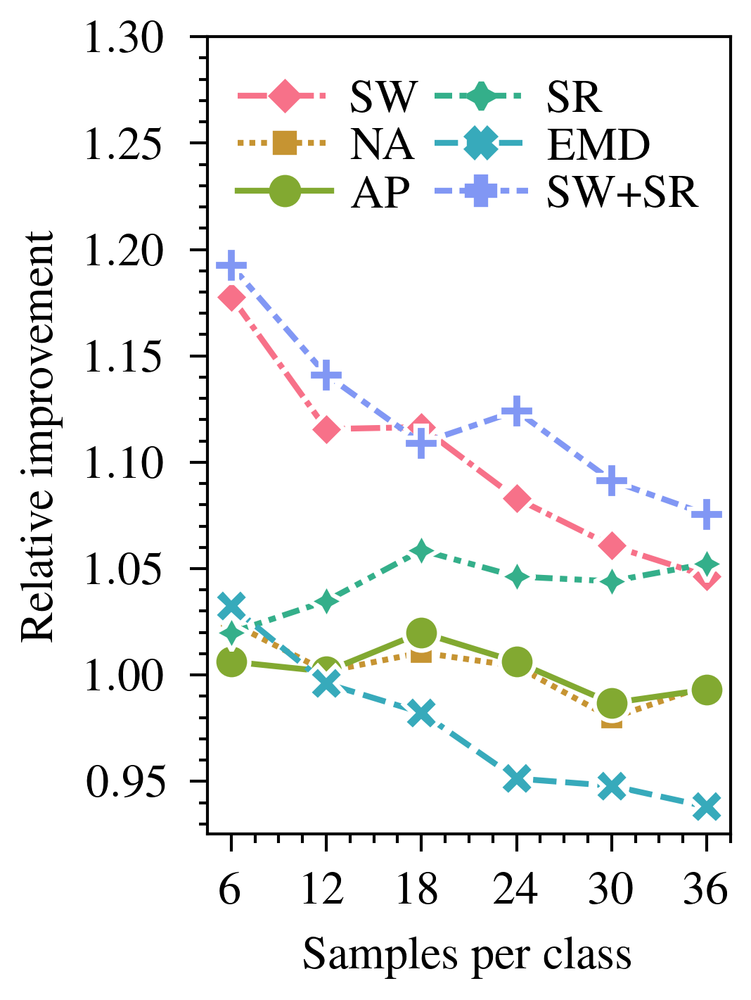

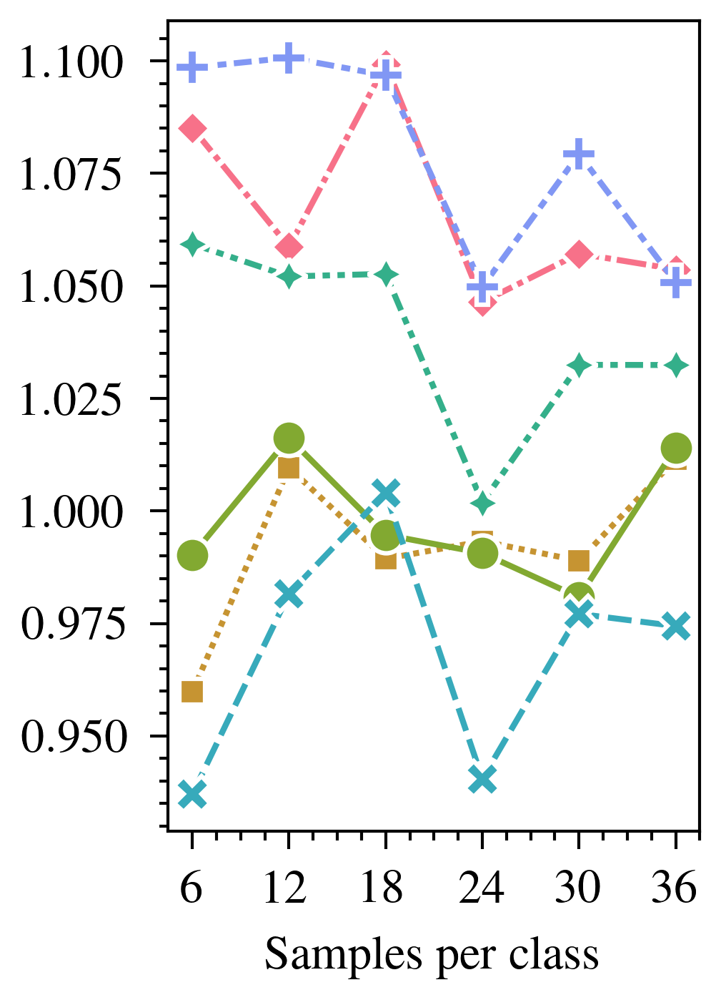

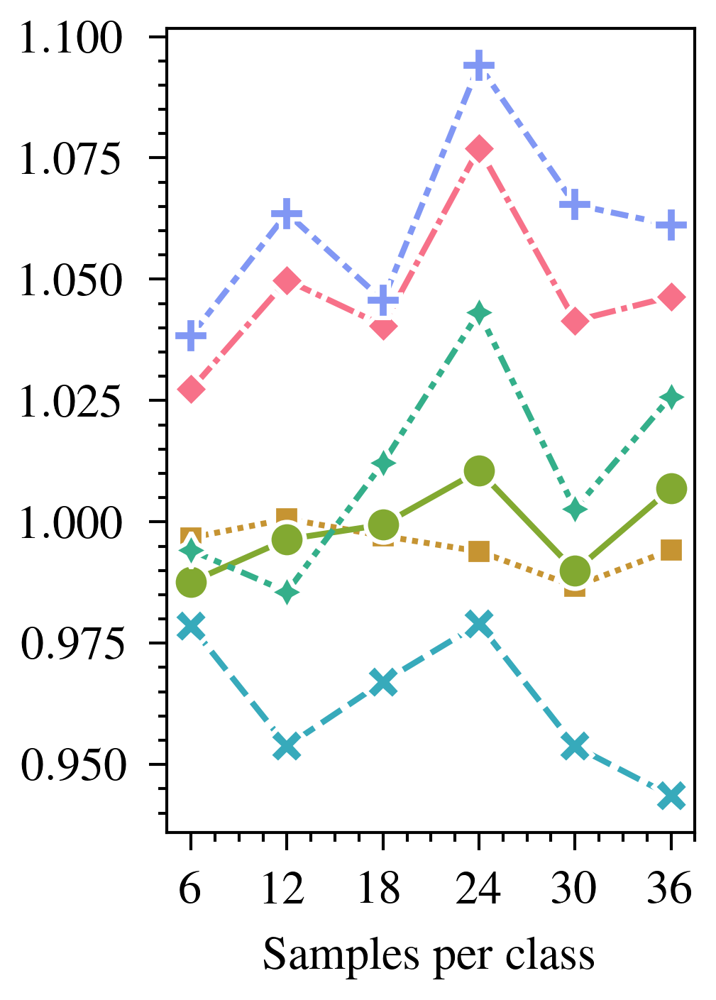

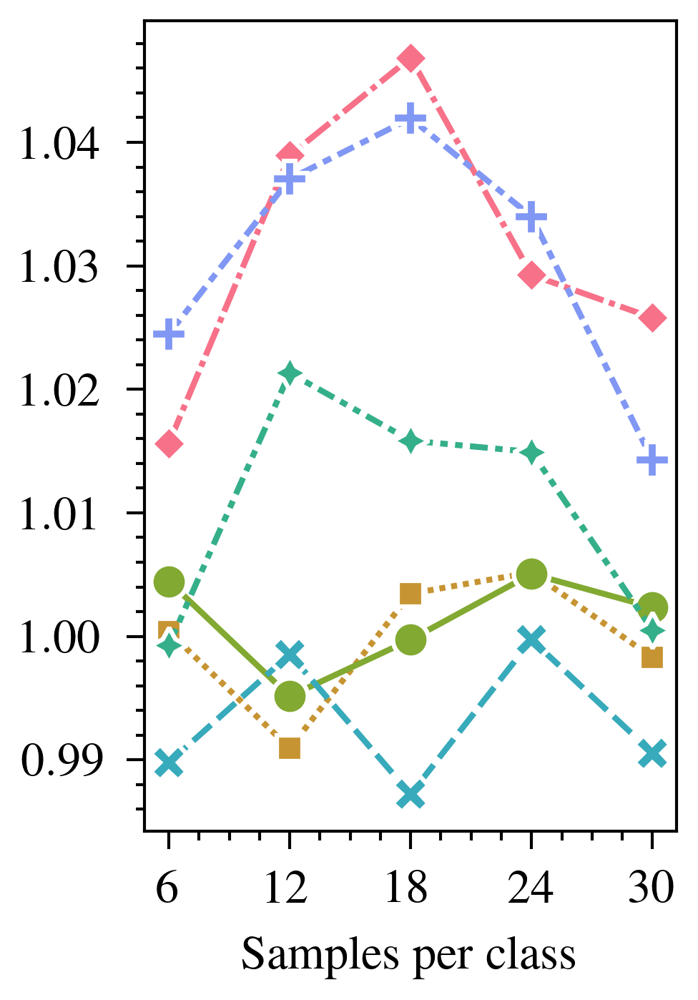

In [11]:
figsize = (1.6, 2.5)

# BCIC-2a (E=22, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] != 3
c4 = df["n_classes"] == 4
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
res = within_session_relative(
    data=data,
    ax=ax,
    hue_order=legend_order[:-1] + [""],
    labels=legend_labels,
    ncol=2,
    legend_visible=True,
)
print(res["relative_accuracy"].mean())
display(res.groupby(["transform"]).describe()["relative_accuracy"])
ax.set_ylim(top=1.3)
fig.savefig("../data/rp_1.pdf", bbox_inches="tight")

# BCIC-2a (E=3, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 3
c4 = df["n_classes"] == 4
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
res = within_session_relative(data=data, ax=ax, hue_order=legend_order[:-1] + [""])
print(res["relative_accuracy"].mean())
display(res.groupby(["transform"]).describe()["relative_accuracy"])
ax.set_ylabel(None)
fig.savefig("../data/rp_2.pdf", bbox_inches="tight")

# BCIC-2a (E=22, C=2)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 2
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
res = within_session_relative(data=data, ax=ax, hue_order=legend_order[:-1] + [""])
print(res["relative_accuracy"].mean())
display(res.groupby(["transform"]).describe()["relative_accuracy"])
ax.set_ylabel(None)
fig.savefig("../data/rp_3.pdf", bbox_inches="tight")

# BCIC-2b
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2b"
c2 = df["intrasession"] == True
c3 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3].copy()
res = within_session_relative(data=data, ax=ax, hue_order=legend_order[:-1] + [""])
print(res["relative_accuracy"].mean())
display(res.groupby(["transform"]).describe()["relative_accuracy"])
ax.set_ylabel(None)
fig.savefig("../data/rp_4.pdf", bbox_inches="tight")

## Within-Session Figures (Absolute)


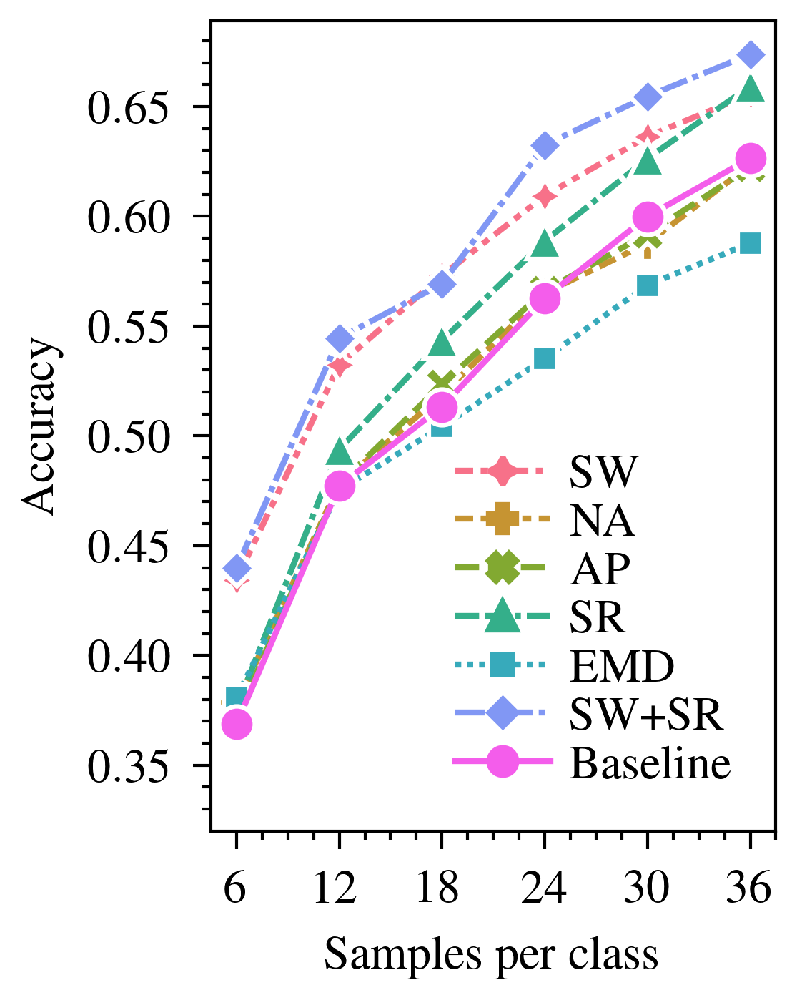

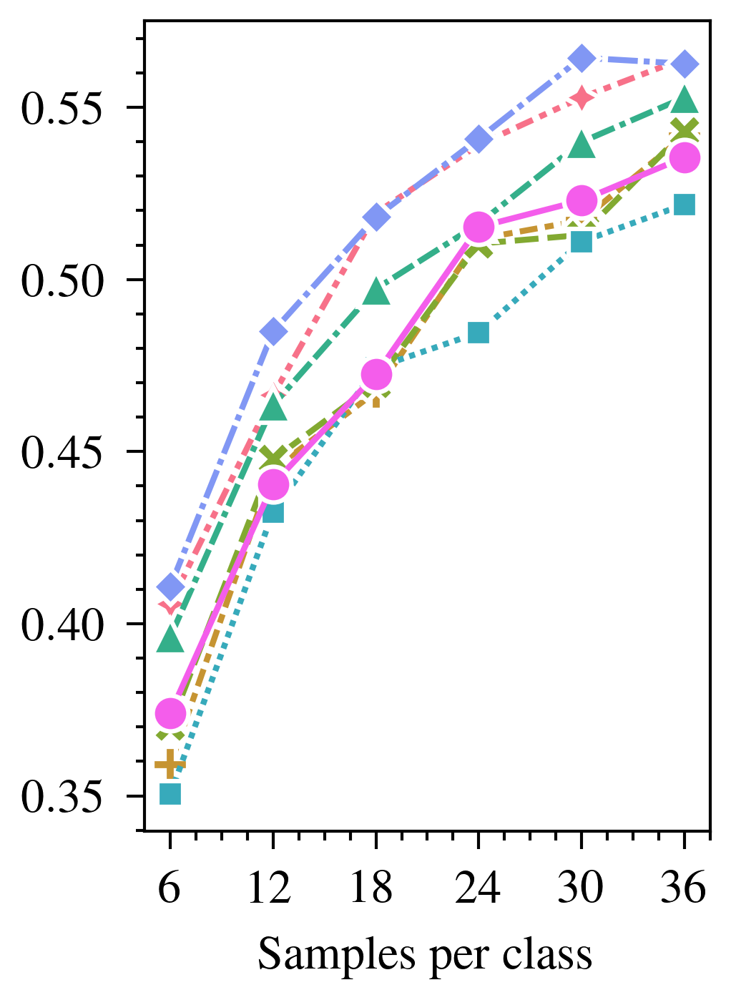

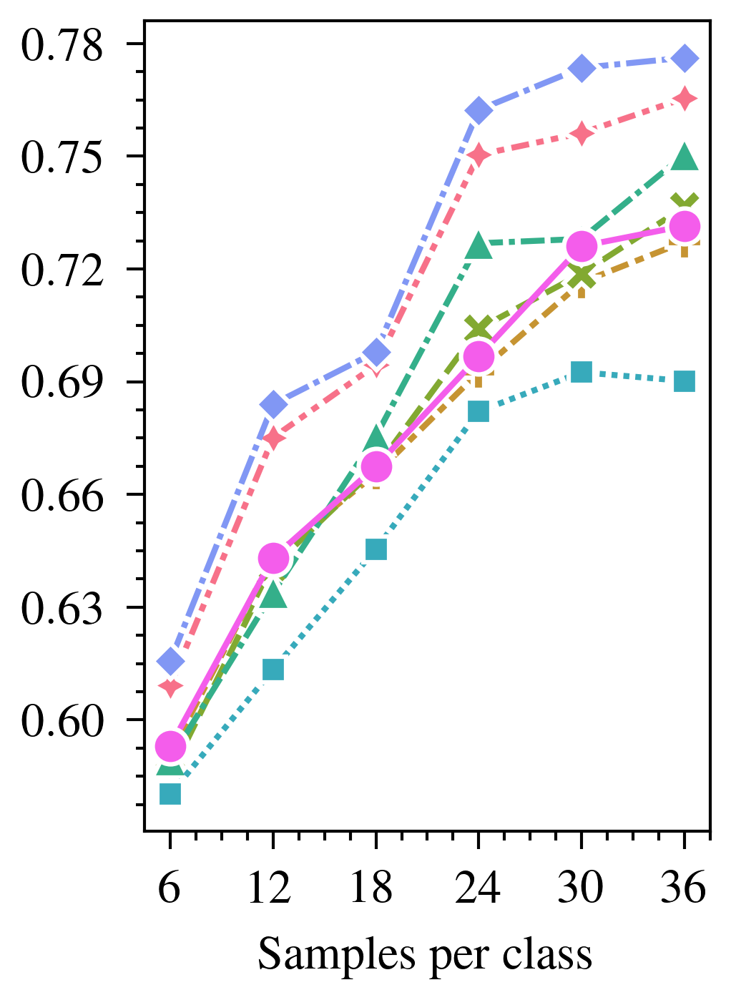

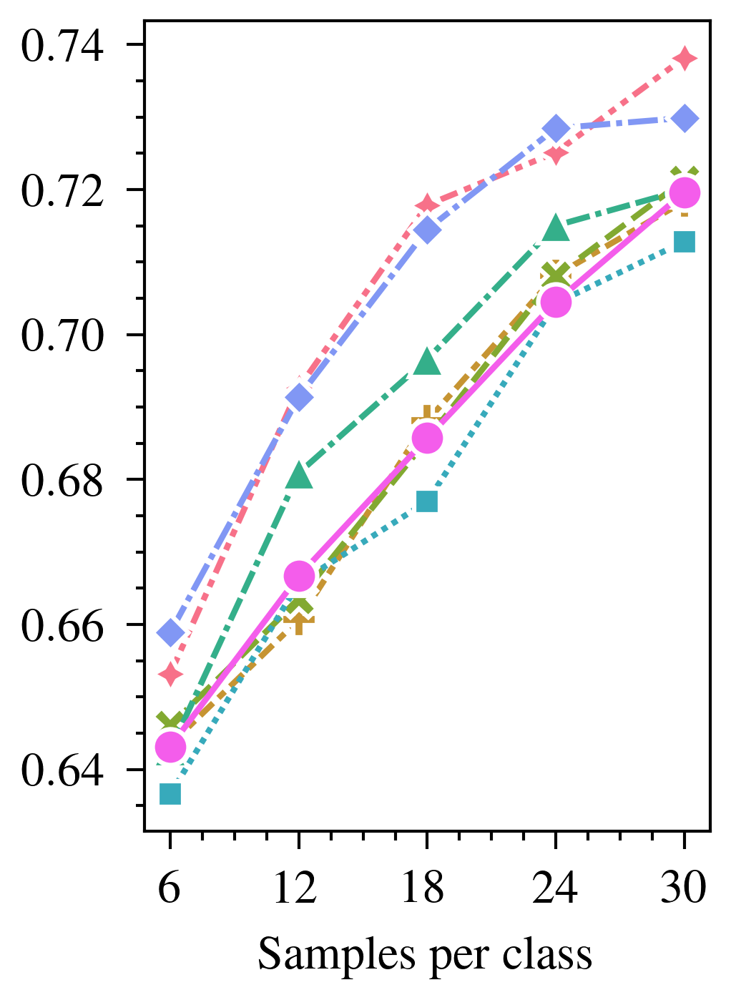

In [12]:
figsize = (1.7, 2.5)

# BCIC-2a (E=22, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] != 3
c4 = df["n_classes"] == 4
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
within_session(
    data=data,
    ax=ax,
    hue_order=legend_order,
    labels=legend_labels,
    ncol=1,
    legend_visible=True,
)
fig.savefig("../data/ap_1.png", bbox_inches="tight")

# BCIC-2a (E=3, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 3
c4 = df["n_classes"] == 4
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
within_session(data=data, ax=ax, hue_order=legend_order)
ax.set_ylabel(None)
fig.savefig("../data/ap_2.png", bbox_inches="tight")

# BCIC-2a (E=22, C=2)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 2
c5 = df["transform"] != "sliding-window"
# Analysis
c6 = df["transform"].isin(["Baseline", "sliding-recombination"])
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
within_session(data=data, ax=ax, hue_order=legend_order)
ax.set_ylabel(None)
ax.yaxis.set_major_locator(plticker.MultipleLocator(base=0.03))
fig.savefig("../data/ap_3.png", bbox_inches="tight")

# BCIC-2b
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2b"
c2 = df["intrasession"] == True
c3 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3].copy()
within_session(data=data, ax=ax, hue_order=legend_order)
ax.set_ylabel(None)
fig.savefig("../data/ap_4.png", bbox_inches="tight")

## Within-Session Table


In [13]:
# Significance test

c_2a = df["dataset"] == "2a"
c_intrasession = df["intrasession"] == True
data = df[c_intrasession].copy()
data.loc[c_2a & data["keep_train"].isna(), "keep_train"] = 36

keep_train_list = [6, 12, 18, 24, 30, 36]
kbs = []
for kt in keep_train_list:
    c_kt = data["keep_train"] == kt
    if c_kt.sum() == 0:
        continue
    kb = statistical_test_alt(data[c_kt], correction_size=23 * 6)
    kb["keep_train"] = kt
    kbs.append(kb)
kb = pd.concat(kbs)
kb = kb.pivot_table(
    index=["transform"], columns=["n_classes", "n_electrodes", "dataset", "keep_train"]
)
kb.sort_index(axis=1, ascending=[False, False, False, True, True]).T[table_order]

transform                                         Baseline  sliding-window-x  \
       n_classes n_electrodes dataset keep_train                               
pvalue 4         22           2a      6                1.0          0.008523   
                                      12               1.0          0.001647   
                                      18               1.0          0.000534   
                                      24               1.0          0.010240   
                                      30               1.0          0.120370   
                                      36               1.0          0.365979   
                 3            2a      6                1.0          1.000000   
                                      12               1.0          0.316945   
                                      18               1.0          0.000287   
                                      24               1.0          1.000000   
                                      30               1.0          0.169360   
                                      36               1.0          0.028396   
       2         22           2a      6                1.0          1.000000   
                                      12               1.0          1.000000   
                                      18               1.0          1.000000   
                                      24               1.0          0.041094   
                                      30               1.0          1.000000   
                                      36               1.0          1.000000   
                 3            2b      6                1.0          1.000000   
                                      12               1.0          0.413370   
                                      18               1.0          0.120619   
                                      24               1.0          0.812818   
                                      30               1.0          0.081680   

transform                                         gaussian  \
       n_classes n_electrodes dataset keep_train             
pvalue 4         22           2a      6                1.0   
                                      12               1.0   
                                      18               1.0   
                                      24               1.0   
                                      30               1.0   
                                      36               1.0   
                 3            2a      6                1.0   
                                      12               1.0   
                                      18               1.0   
                                      24               1.0   
                                      30               1.0   
                                      36               1.0   
       2         22           2a      6                1.0   
                                      12               1.0   
                                      18               1.0   
                                      24               1.0   
                                      30               1.0   
                                      36               1.0   
                 3            2b      6                1.0   
                                      12               1.0   
                                      18               1.0   
                                      24               1.0   
                                      30               1.0   

transform                                         amplitude-perturbation-15  \
       n_classes n_electrodes dataset keep_train                              
pvalue 4         22           2a      6                                 1.0   
                                      12                                1.0   
                                      18                                1.0   
                                      24             

In [14]:
kb = pd.concat(kbs)

c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] != 3
c4 = df["n_classes"] == 4
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36

data = (
    data.groupby(["keep_train", "transform"])["test_accuracy"].describe().reset_index()
)
data["mean_std"] = data.apply(
    lambda row: f"{round(row['mean'], 3):.3f} $\pm$ {round(row['std'], 3):.3f}",
    axis=1,
)
data = data[["keep_train", "transform", "mean_std"]]
table = pd.pivot_table(
    data, values="mean_std", index="transform", columns="keep_train", aggfunc="first"
).reindex(table_order)
table.columns = list(map(int, table.columns))
table.apply(bold_best, axis=0)
# for kt in table.columns:
#     for transform in table.index:
#         c_transform = kb["transform"] == transform
#         c_keeptrain = kb["keep_train"] == kt
#         c_dataset = kb["dataset"] == "2a"
#         c_electrodes = kb["n_electrodes"] == 22
#         c_classes = kb["n_classes"] == 4
#         pvalue = kb[c_transform & c_keeptrain & c_dataset & c_electrodes & c_classes][
#             "pvalue"
#         ].iloc[0]
#         table.loc[transform, kt] = enclose_pvalue(table.loc[transform, kt], pvalue)
table.index = table_labels

with pd.option_context("max_colwidth", 10000):
    print(table.T.to_latex(escape=False))

\begin{tabular}{llllllll}
\toprule
{} &           Baseline &                          SW &                 NA &                 AP &                 SR &                EMD &                       SW+SR \\
\midrule
6  &  0.369 $\pm$ 0.134 &           0.434 $\pm$ 0.172 &  0.378 $\pm$ 0.140 &  0.371 $\pm$ 0.132 &  0.376 $\pm$ 0.144 &  0.381 $\pm$ 0.130 &  \textbf{0.440 $\pm$ 0.181} \\
12 &  0.477 $\pm$ 0.170 &           0.532 $\pm$ 0.179 &  0.478 $\pm$ 0.177 &  0.478 $\pm$ 0.174 &  0.494 $\pm$ 0.186 &  0.475 $\pm$ 0.164 &  \textbf{0.545 $\pm$ 0.181} \\
18 &  0.513 $\pm$ 0.193 &  \textbf{0.573 $\pm$ 0.181} &  0.519 $\pm$ 0.201 &  0.524 $\pm$ 0.195 &  0.543 $\pm$ 0.186 &  0.504 $\pm$ 0.169 &           0.569 $\pm$ 0.192 \\
24 &  0.563 $\pm$ 0.185 &           0.609 $\pm$ 0.177 &  0.565 $\pm$ 0.193 &  0.566 $\pm$ 0.187 &  0.589 $\pm$ 0.205 &  0.535 $\pm$ 0.182 &  \textbf{0.633 $\pm$ 0.183} \\
30 &  0.600 $\pm$ 0.189 &           0.636 $\pm$ 0.178 &  0.588 $\pm$ 0.187 &  0.592 $\pm$ 0.188 &  0.

In [15]:
kb = pd.concat(kbs)

c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 3
c4 = df["n_classes"] == 4
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36

data = (
    data.groupby(["keep_train", "transform"])["test_accuracy"].describe().reset_index()
)
data["mean_std"] = data.apply(
    lambda row: f"{round(row['mean'], 3):.3f} $\pm$ {round(row['std'], 3):.3f}",
    axis=1,
)
data = data[["keep_train", "transform", "mean_std"]]
table = pd.pivot_table(
    data, values="mean_std", index="transform", columns="keep_train", aggfunc="first"
).reindex(table_order)
table.columns = list(map(int, table.columns))
table.apply(bold_best, axis=0)
# for kt in table.columns:
#     for transform in table.index:
#         c_transform = kb["transform"] == transform
#         c_keeptrain = kb["keep_train"] == kt
#         c_dataset = kb["dataset"] == "2a"
#         c_electrodes = kb["n_electrodes"] == 3
#         c_classes = kb["n_classes"] == 4
#         pvalue = kb[c_transform & c_keeptrain & c_dataset & c_electrodes & c_classes][
#             "pvalue"
#         ].iloc[0]
#         table.loc[transform, kt] = enclose_pvalue(table.loc[transform, kt], pvalue)
table.index = table_labels

with pd.option_context("max_colwidth", 10000):
    print(table.T.to_latex(escape=False))

\begin{tabular}{llllllll}
\toprule
{} &           Baseline &                          SW &                 NA &                 AP &                 SR &                EMD &                       SW+SR \\
\midrule
6  &  0.374 $\pm$ 0.126 &           0.406 $\pm$ 0.139 &  0.359 $\pm$ 0.126 &  0.370 $\pm$ 0.124 &  0.396 $\pm$ 0.130 &  0.351 $\pm$ 0.123 &  \textbf{0.411 $\pm$ 0.157} \\
12 &  0.441 $\pm$ 0.135 &           0.466 $\pm$ 0.139 &  0.445 $\pm$ 0.139 &  0.448 $\pm$ 0.141 &  0.464 $\pm$ 0.155 &  0.432 $\pm$ 0.142 &  \textbf{0.485 $\pm$ 0.145} \\
18 &  0.472 $\pm$ 0.154 &  \textbf{0.519 $\pm$ 0.135} &  0.467 $\pm$ 0.155 &  0.470 $\pm$ 0.151 &  0.497 $\pm$ 0.154 &  0.474 $\pm$ 0.143 &           0.518 $\pm$ 0.136 \\
24 &  0.515 $\pm$ 0.144 &           0.539 $\pm$ 0.116 &  0.512 $\pm$ 0.152 &  0.510 $\pm$ 0.141 &  0.516 $\pm$ 0.135 &  0.485 $\pm$ 0.147 &  \textbf{0.541 $\pm$ 0.117} \\
30 &  0.523 $\pm$ 0.130 &           0.553 $\pm$ 0.119 &  0.517 $\pm$ 0.134 &  0.513 $\pm$ 0.131 &  0.

In [16]:
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 2
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36

data = (
    data.groupby(["keep_train", "transform"])["test_accuracy"].describe().reset_index()
)
data["mean_std"] = data.apply(
    lambda row: f"{round(row['mean'], 3):.3f} $\pm$ {round(row['std'], 3):.3f}",
    axis=1,
)
data = data[["keep_train", "transform", "mean_std"]]
table = pd.pivot_table(
    data, values="mean_std", index="transform", columns="keep_train", aggfunc="first"
).reindex(table_order)
table.columns = list(map(int, table.columns))
table.apply(bold_best, axis=0)
# for kt in table.columns:
#     for transform in table.index:
#         c_transform = kb["transform"] == transform
#         c_keeptrain = kb["keep_train"] == kt
#         c_dataset = kb["dataset"] == "2a"
#         c_electrodes = kb["n_electrodes"] == 22
#         c_classes = kb["n_classes"] == 2
#         pvalue = kb[c_transform & c_keeptrain & c_dataset & c_electrodes & c_classes][
#             "pvalue"
#         ].iloc[0]
#         table.loc[transform, kt] = enclose_pvalue(table.loc[transform, kt], pvalue)
table.index = table_labels

with pd.option_context("max_colwidth", 10000):
    print(table.T.to_latex(escape=False))

\begin{tabular}{llllllll}
\toprule
{} &           Baseline &                 SW &                 NA &                 AP &                 SR &                EMD &                       SW+SR \\
\midrule
6  &  0.593 $\pm$ 0.153 &  0.609 $\pm$ 0.155 &  0.591 $\pm$ 0.153 &  0.586 $\pm$ 0.148 &  0.590 $\pm$ 0.158 &  0.580 $\pm$ 0.157 &  \textbf{0.616 $\pm$ 0.173} \\
12 &  0.643 $\pm$ 0.170 &  0.675 $\pm$ 0.186 &  0.644 $\pm$ 0.178 &  0.641 $\pm$ 0.177 &  0.634 $\pm$ 0.178 &  0.613 $\pm$ 0.173 &  \textbf{0.684 $\pm$ 0.183} \\
18 &  0.667 $\pm$ 0.175 &  0.694 $\pm$ 0.195 &  0.666 $\pm$ 0.179 &  0.667 $\pm$ 0.183 &  0.676 $\pm$ 0.193 &  0.645 $\pm$ 0.190 &  \textbf{0.698 $\pm$ 0.193} \\
24 &  0.697 $\pm$ 0.181 &  0.750 $\pm$ 0.181 &  0.693 $\pm$ 0.186 &  0.704 $\pm$ 0.182 &  0.727 $\pm$ 0.180 &  0.682 $\pm$ 0.192 &  \textbf{0.762 $\pm$ 0.175} \\
30 &  0.726 $\pm$ 0.185 &  0.756 $\pm$ 0.171 &  0.716 $\pm$ 0.182 &  0.719 $\pm$ 0.190 &  0.728 $\pm$ 0.182 &  0.693 $\pm$ 0.200 &  \textbf{0.774 

In [17]:
c1 = df["dataset"] == "2b"
c2 = df["intrasession"] == True
c3 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3].copy()

data = (
    data.groupby(["keep_train", "transform"])["test_accuracy"].describe().reset_index()
)
data["mean_std"] = data.apply(
    lambda row: f"{round(row['mean'], 3):.3f} $\pm$ {round(row['std'], 3):.3f}",
    axis=1,
)
data = data[["keep_train", "transform", "mean_std"]]
table = pd.pivot_table(
    data, values="mean_std", index="transform", columns="keep_train", aggfunc="first"
).reindex(table_order)
table.columns = list(map(int, table.columns))
table.apply(bold_best, axis=0)
# for kt in table.columns:
#     for transform in table.index:
#         c_transform = kb["transform"] == transform
#         c_keeptrain = kb["keep_train"] == kt
#         c_dataset = kb["dataset"] == "2b"
#         c_electrodes = kb["n_electrodes"] == 3
#         c_classes = kb["n_classes"] == 2
#         pvalue = kb[c_transform & c_keeptrain & c_dataset & c_electrodes & c_classes][
#             "pvalue"
#         ].iloc[0]
#         table.loc[transform, kt] = enclose_pvalue(table.loc[transform, kt], pvalue)
table.index = table_labels


with pd.option_context("max_colwidth", 10000):
    print(table.T.to_latex(escape=False))

\begin{tabular}{llllllll}
\toprule
{} &           Baseline &                          SW &                 NA &                 AP &                 SR &                EMD &                       SW+SR \\
\midrule
6  &  0.643 $\pm$ 0.167 &           0.653 $\pm$ 0.170 &  0.643 $\pm$ 0.168 &  0.646 $\pm$ 0.166 &  0.643 $\pm$ 0.169 &  0.637 $\pm$ 0.168 &  \textbf{0.659 $\pm$ 0.172} \\
12 &  0.667 $\pm$ 0.174 &  \textbf{0.693 $\pm$ 0.179} &  0.661 $\pm$ 0.177 &  0.663 $\pm$ 0.173 &  0.681 $\pm$ 0.179 &  0.666 $\pm$ 0.174 &           0.691 $\pm$ 0.182 \\
18 &  0.686 $\pm$ 0.187 &  \textbf{0.718 $\pm$ 0.183} &  0.688 $\pm$ 0.187 &  0.686 $\pm$ 0.189 &  0.697 $\pm$ 0.184 &  0.677 $\pm$ 0.188 &           0.714 $\pm$ 0.190 \\
24 &  0.704 $\pm$ 0.184 &           0.725 $\pm$ 0.175 &  0.708 $\pm$ 0.187 &  0.708 $\pm$ 0.186 &  0.715 $\pm$ 0.187 &  0.704 $\pm$ 0.182 &  \textbf{0.728 $\pm$ 0.180} \\
30 &  0.720 $\pm$ 0.178 &  \textbf{0.738 $\pm$ 0.173} &  0.718 $\pm$ 0.179 &  0.721 $\pm$ 0.177 &  0.

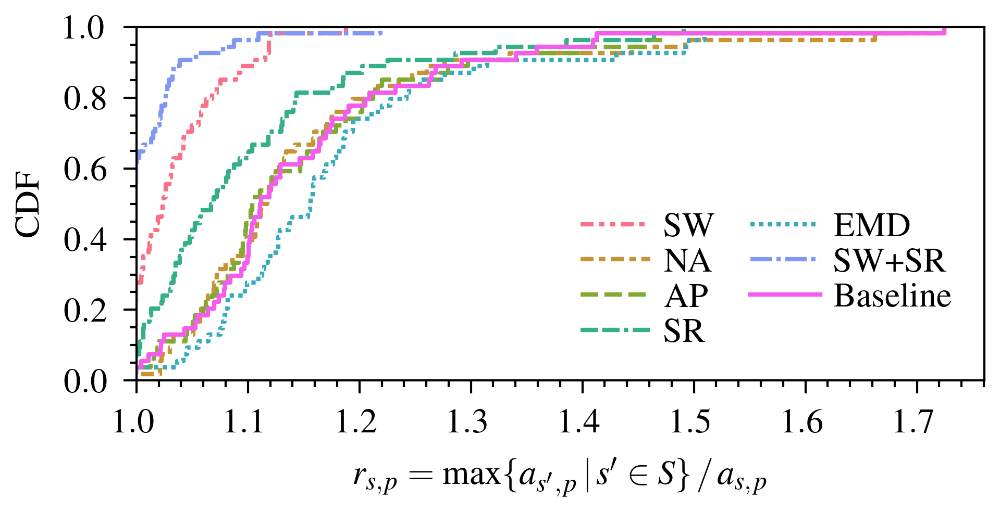

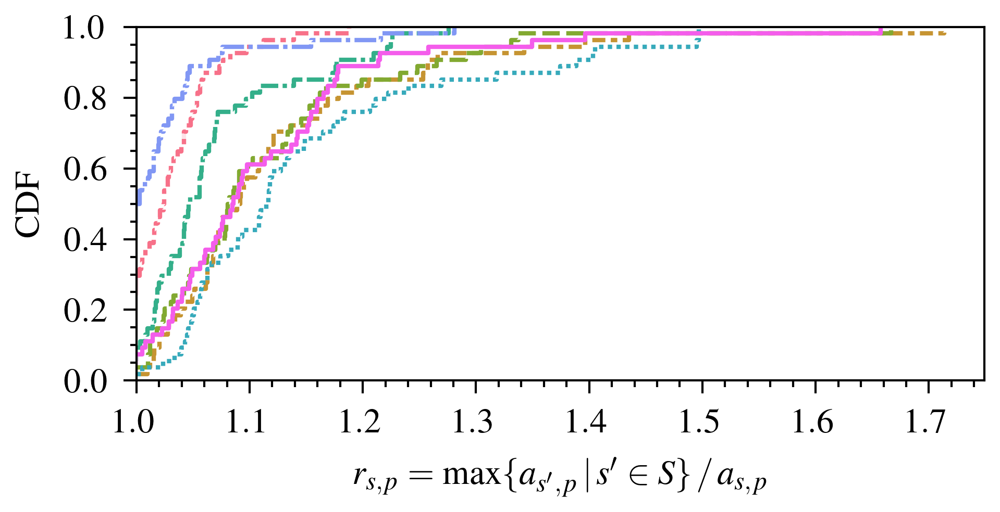

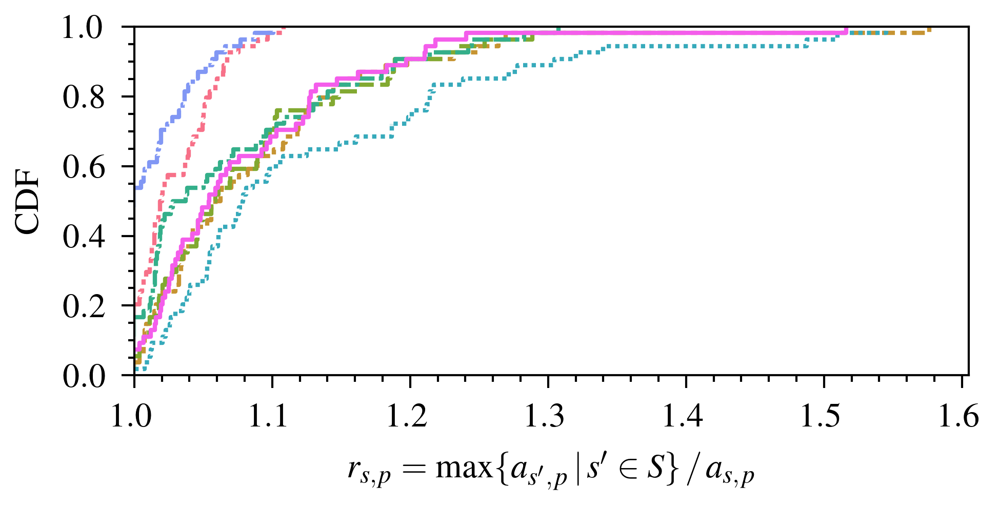

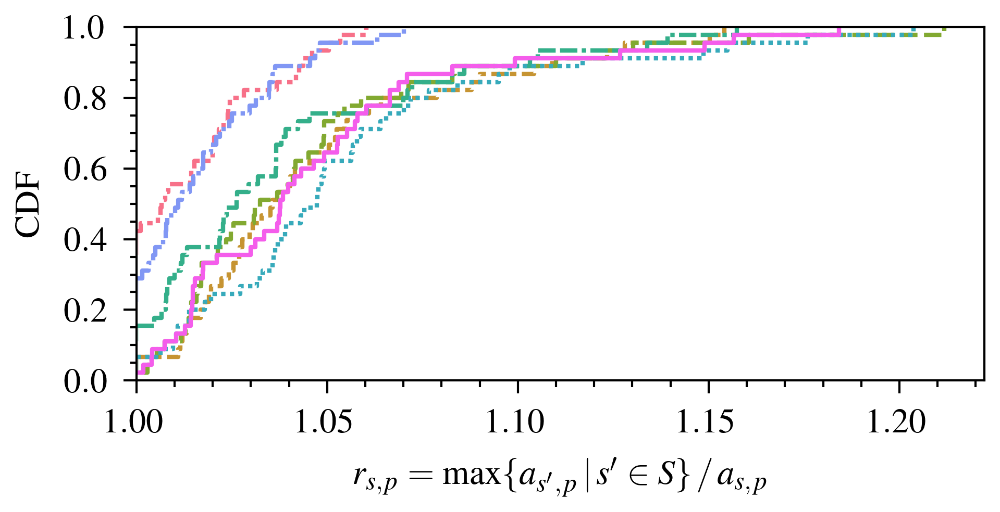

In [18]:
figsize = (3.5, 1.5)

# BCIC-2a (E=22, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] != 3
c4 = df["n_classes"] == 4
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
performance_profile(
    data=data, ax=ax, hue_order=legend_order, legend_labels=legend_labels
)
fig.savefig("../data/pp_1.pdf", bbox_inches="tight")

# BCIC-2a (E=3, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 3
c4 = df["n_classes"] == 4
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
performance_profile(data=data, ax=ax, hue_order=legend_order)
fig.savefig("../data/pp_2.pdf", bbox_inches="tight")

# BCIC-2a (E=22, C=2)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 2
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
performance_profile(data=data, ax=ax, hue_order=legend_order)
fig.savefig("../data/pp_3.pdf", bbox_inches="tight")

# BCIC-2b
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2b"
c2 = df["intrasession"] == True
c3 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3].copy()
performance_profile(data=data, ax=ax, hue_order=legend_order)
fig.savefig("../data/pp_4.pdf", bbox_inches="tight")

## Performance Profile


,x,y
transform,,
Baseline,1.0,0.065844
amplitude-perturbation-15,1.0,0.037037
emd,1.0,0.028807
gaussian,1.0,0.028807
sliding-recombination,1.0,0.456790
sliding-window-x,1.0,0.300412
stft-recombination,1.0,0.139918


,x,y
transform,,
Baseline,1.724324,1.0
amplitude-perturbation-15,1.678947,1.0
emd,1.653409,1.0
gaussian,1.724324,1.0
sliding-recombination,1.281046,1.0
sliding-window-x,1.187879,1.0
stft-recombination,1.490654,1.0


KruskalResult(statistic=415.35961821566195, pvalue=1.3923414121332774e-86)


,Baseline,SW,NA,AP,SR,EMD,SW+SR
Baseline,$1.000 \times 10^{0}$,$\mathbf{6.881 \times 10^{-20}}$,$1.000 \times 10^{0}$,$1.000 \times 10^{0}$,$\mathbf{4.216 \times 10^{-3}}$,$\mathbf{2.124 \times 10^{-3}}$,$\mathbf{1.041 \times 10^{-32}}$
SW,$\mathbf{6.881 \times 10^{-20}}$,$1.000 \times 10^{0}$,$\mathbf{8.748 \times 10^{-24}}$,$\mathbf{1.437 \times 10^{-20}}$,$\mathbf{2.042 \times 10^{-7}}$,$\mathbf{2.795 \times 10^{-39}}$,$1.420 \times 10^{-1}$
NA,$1.000 \times 10^{0}$,$\mathbf{8.748 \times 10^{-24}}$,$1.000 \times 10^{0}$,$1.000 \times 10^{0}$,$\mathbf{8.256 \times 10^{-5}}$,$5.842 \times 10^{-2}$,$\mathbf{1.188 \times 10^{-37}}$
AP,$1.000 \times 10^{0}$,$\mathbf{1.437 \times 10^{-20}}$,$1.000 \times 10^{0}$,$1.000 \times 10^{0}$,$\mathbf{2.189 \times 10^{-3}}$,$\mathbf{4.097 \times 10^{-3}}$,$\mathbf{1.405 \times 10^{-33}}$
SR,$\mathbf{4.216 \times 10^{-3}}$,$\mathbf{2.042 \times 10^{-7}}$,$\mathbf{8.256 \times 10^{-5}}$,$\mathbf{2.189 \times 10^{-3}}$,$1.000 \times 10^{0}$,$\mathbf{5.944 \times 10^{-13}}$,$\mathbf{6.446 \times 10^{-16}}$
EMD,$\mathbf{2.124 \times 10^{-3}}$,$\mathbf{2.795 \times 10^{-39}}$,$5.842 \times 10^{-2}$,$\mathbf{4.097 \times 10^{-3}}$,$\mathbf{5.944 \times 10^{-13}}$,$1.000 \times 10^{0}$,$\mathbf{1.206 \times 10^{-56}}$
SW+SR,$\mathbf{1.041 \times 10^{-32}}$,$1.420 \times 10^{-1}$,$\mathbf{1.188 \times 10^{-37}}$,$\mathbf{1.405 \times 10^{-33}}$,$\mathbf{6.446 \times 10^{-16}}$,$\mathbf{1.206 \times 10^{-56}}$,$1.000 \times 10^{0}$


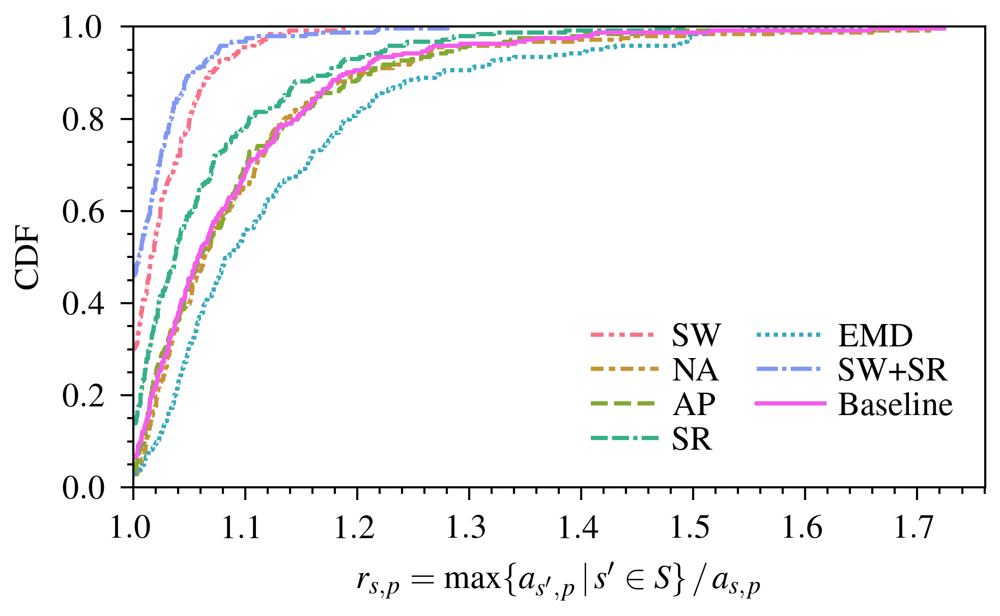

In [19]:
def pvalue(x):
    from num2tex import num2tex

    if x < 0.05:
        return "$\mathbf{{{:.3e}}}$".format(num2tex(x))
    else:
        return "${:.3e}$".format(num2tex(x))


figsize = (3 * 1.2, 2 * 1)
fig, ax = plt.subplots(figsize=figsize)

c0 = df["dataset"] == "2b"
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"].isna()
c4 = df["n_classes"].isna()
c5 = df["keep_train"].isna()
c_ult = df["dataset"] != "2b"

data = df.copy()
data.loc[c1 & c2 & c5, "keep_train"] = 36
data.loc[c1 & c3, "n_electrodes"] = 22
data.loc[c1 & c4, "n_classes"] = 4
data.loc[c0 & c3, "n_electrodes"] = 3
data.loc[c0 & c4, "n_classes"] = 2
data.loc[~c2 & c5, "keep_train"] = 1000
data.loc[~c2, "session"] = 0

dfg = performance_profile(
    data=data, ax=ax, hue_order=legend_order, legend_labels=legend_labels
)

# ticks = list(np.arange(1, 1.4, 0.1)) + [1.75]
# subticks = list(np.arange(1, 1.76, 0.1 / 5))
# ticks_mod = [adjust(x) for x in ticks]
# subticks_mod = [adjust(x) for x in subticks]
# ax.set_xticks(ticks_mod)
# ax.set_xticks(subticks_mod, minor=True)
# ax.set_xticklabels([f"{round(x, 2):.1f}" for x in ticks])

# ticks = [0, 0.5, 0.6, 0.7, 0.8, 0.9, 1]
# subticks = list(np.arange(0, 0.501, 0.1 / 5)) + list(np.arange(0.5, 1.01, 0.1 / 5))
# ticks_mod = [y ** 3 for y in ticks]
# subticks_mod = [y ** 3 for y in subticks]
# ax.set_yticks(ticks_mod)
# ax.set_yticks(subticks_mod, minor=True)
# ax.set_yticklabels([f"{round(y, 2):.1f}" for y in ticks])

fig.savefig("../data/pp.pdf", bbox_inches="tight")
# How many times (%) was it the best?
display(dfg[dfg["x"] == 1].groupby("transform").max())
# What is the reliability score?
display(dfg[dfg["y"] == 1].groupby("transform").min())

# Check best and most reliable
# display(dfg[dfg["transform"] == "sliding-recombination"])
# display(dfg[dfg["transform"] == "sliding-window-x"])
# display(
#     (
#         dfg[dfg["transform"] == "sliding-recombination"]
#         .sort_values("x")
#         .reset_index()["x"]
#         < dfg[dfg["transform"] == "sliding-window-x"]
#         .sort_values("x")
#         .reset_index()["x"]
#     ).sum()
# )

dfg.index = dfg.groupby("transform")["transform"].cumcount()
data = dfg.pivot(columns="transform", values="x").rename_axis(columns=None)
print(kruskalwallis(*data.T.to_numpy()))
phdunn = skp.posthoc_dunn(
    dfg, group_col="transform", val_col="x", p_adjust="bonferroni"
)
phdunn = phdunn[table_order]
phdunn.columns = table_labels
phdunn = phdunn.reindex(table_order)
phdunn.index = table_labels
phdunn = phdunn.applymap(pvalue)
display(phdunn)
# print(phdunn.to_latex(escape=False))


## Robustness (Each)


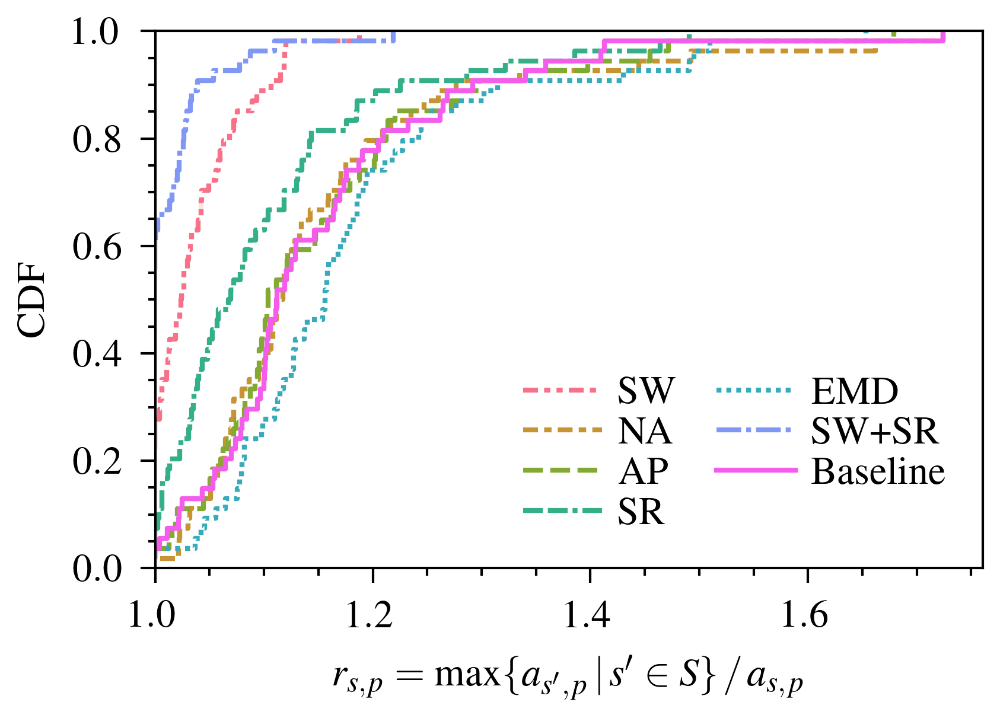

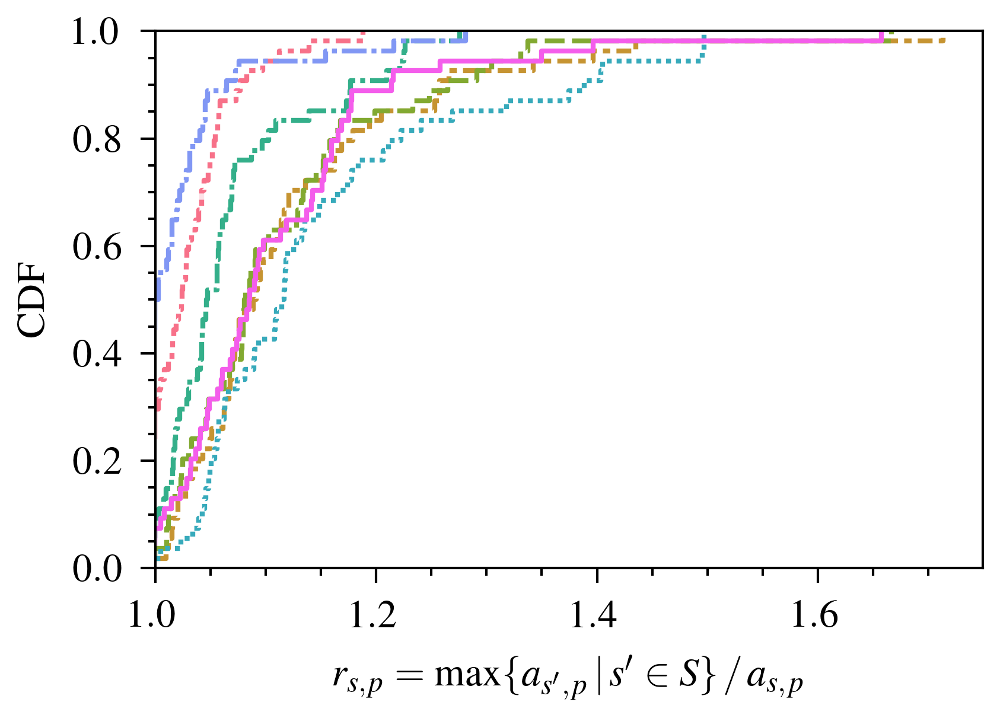

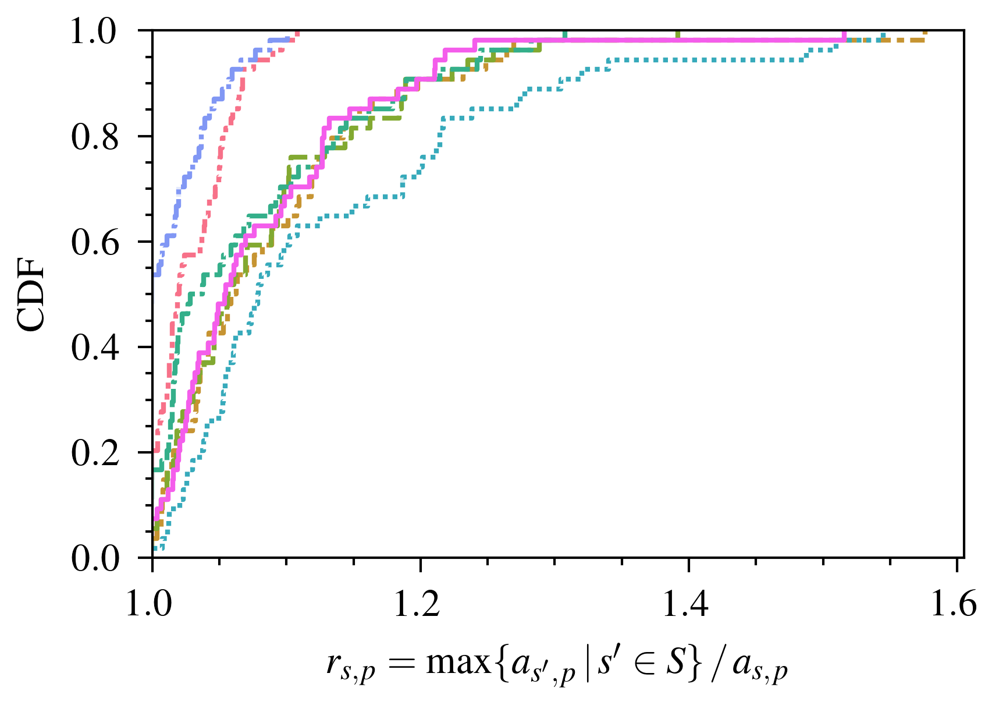

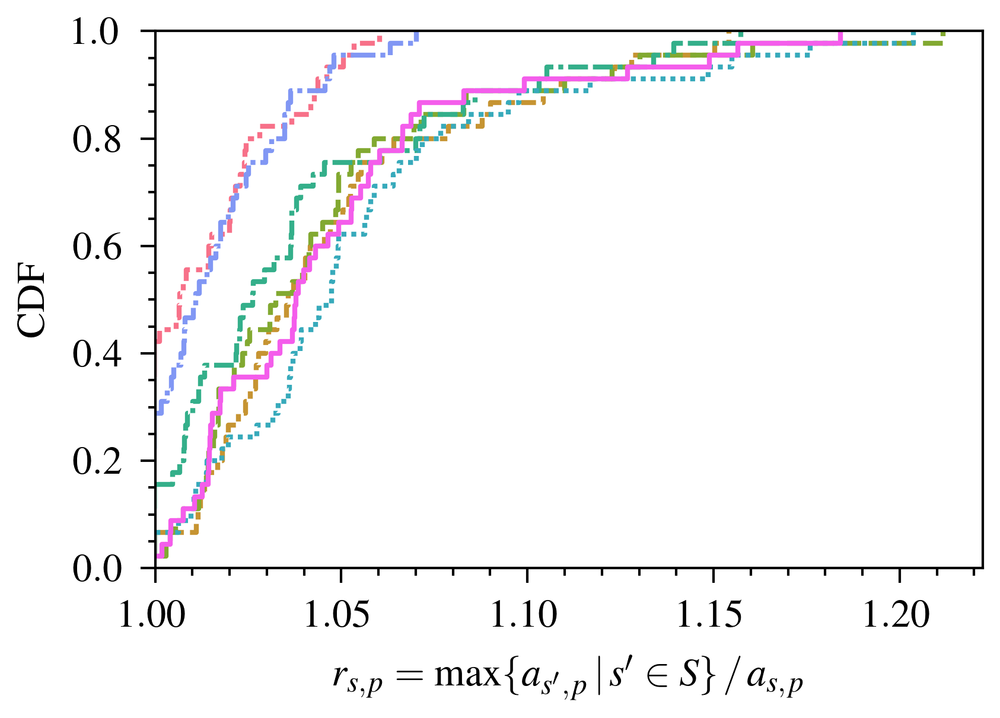

In [20]:
figsize = (3, 2)

dfx = df.copy()
c_2a = dfx["dataset"] == "2a"
c_2b = dfx["dataset"] == "2b"
c_class_nan = dfx["n_classes"].isnull()
c_electrodes_nan = dfx["n_electrodes"].isnull()
dfx.loc[c_2a & c_electrodes_nan, "n_electrodes"] = 22
dfx.loc[c_2a & c_class_nan, "n_classes"] = 4
dfx.loc[c_2b & c_electrodes_nan, "n_electrodes"] = 3
dfx.loc[c_2b & c_class_nan, "n_classes"] = 2

# BCIC-2a (E=22, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = dfx["dataset"] == "2a"
c2 = dfx["intrasession"] == True
c3 = dfx["n_electrodes"] != 3
c4 = dfx["n_classes"] == 4
c5 = dfx["transform"] != "sliding-window"
data = dfx[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
performance_profile(
    data=data, ax=ax, hue_order=legend_order, legend_labels=legend_labels
)
fig.savefig("../data/pp_1.pdf", bbox_inches="tight")

# BCIC-2a (E=3, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = dfx["dataset"] == "2a"
c2 = dfx["intrasession"] == True
c3 = dfx["n_electrodes"] == 3
c4 = dfx["n_classes"] == 4
c5 = dfx["transform"] != "sliding-window"
data = dfx[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
performance_profile(data=data, ax=ax, hue_order=legend_order)
fig.savefig("../data/pp_2.pdf", bbox_inches="tight")

# BCIC-2a (E=22, C=2)
fig, ax = plt.subplots(figsize=figsize)
c1 = dfx["dataset"] == "2a"
c2 = dfx["intrasession"] == True
c3 = dfx["n_electrodes"] == 22
c4 = dfx["n_classes"] == 2
c5 = dfx["transform"] != "sliding-window"
data = dfx[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
performance_profile(data=data, ax=ax, hue_order=legend_order)
fig.savefig("../data/pp_3.pdf", bbox_inches="tight")

# BCIC-2b
fig, ax = plt.subplots(figsize=figsize)
c1 = dfx["dataset"] == "2b"
c2 = dfx["intrasession"] == True
c3 = dfx["transform"] != "sliding-window"
data = dfx[c1 & c2 & c3].copy()
performance_profile(data=data, ax=ax, hue_order=legend_order)
fig.savefig("../data/pp_4.pdf", bbox_inches="tight")

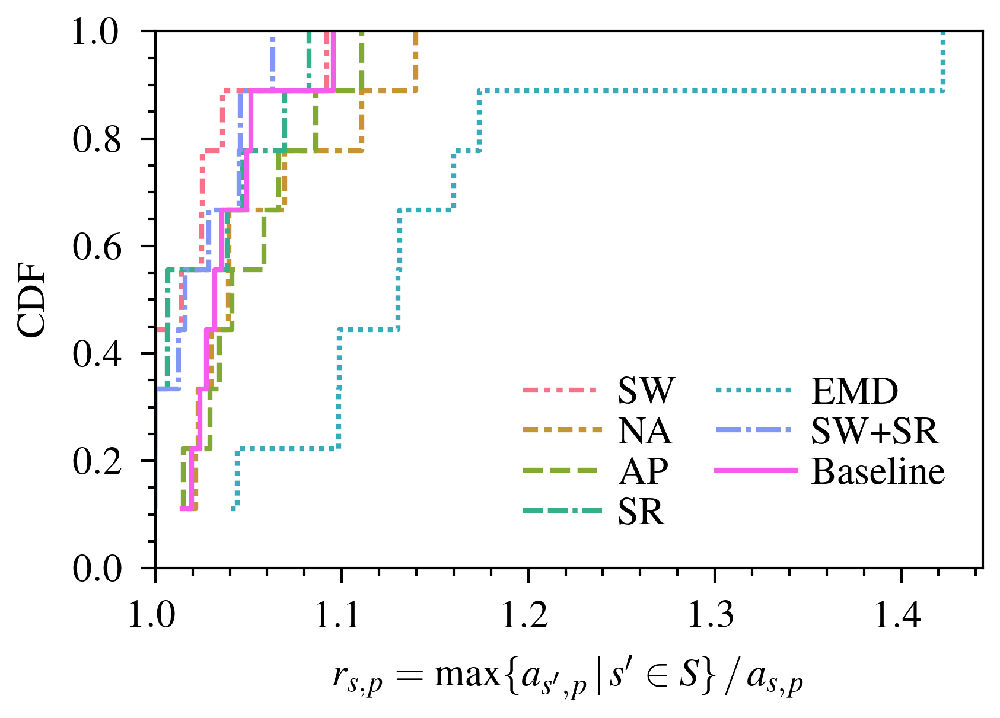

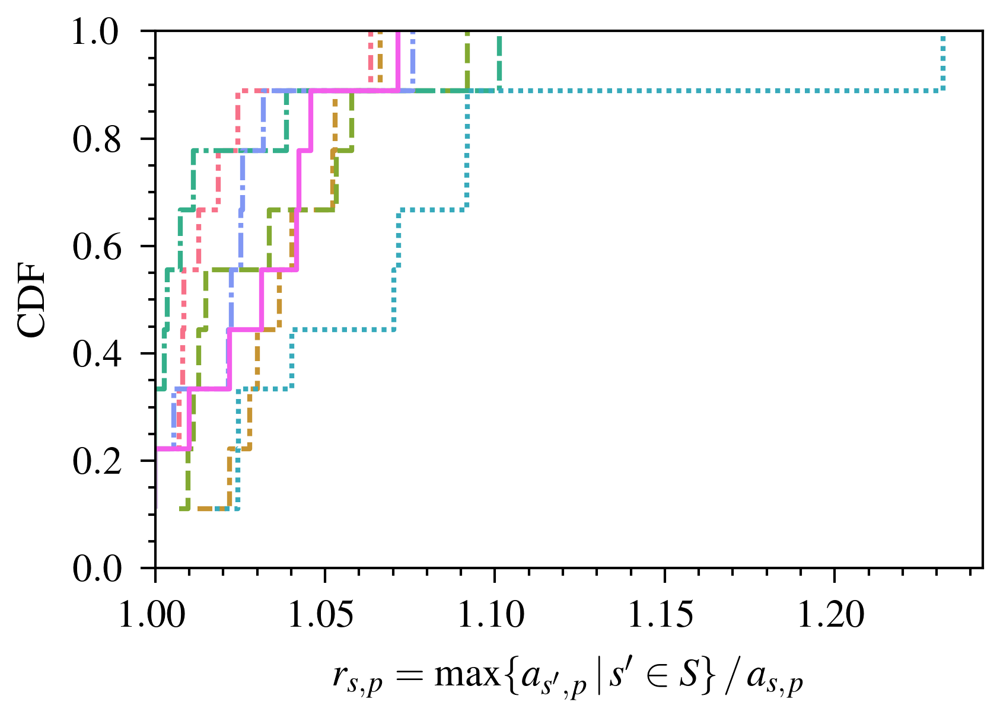

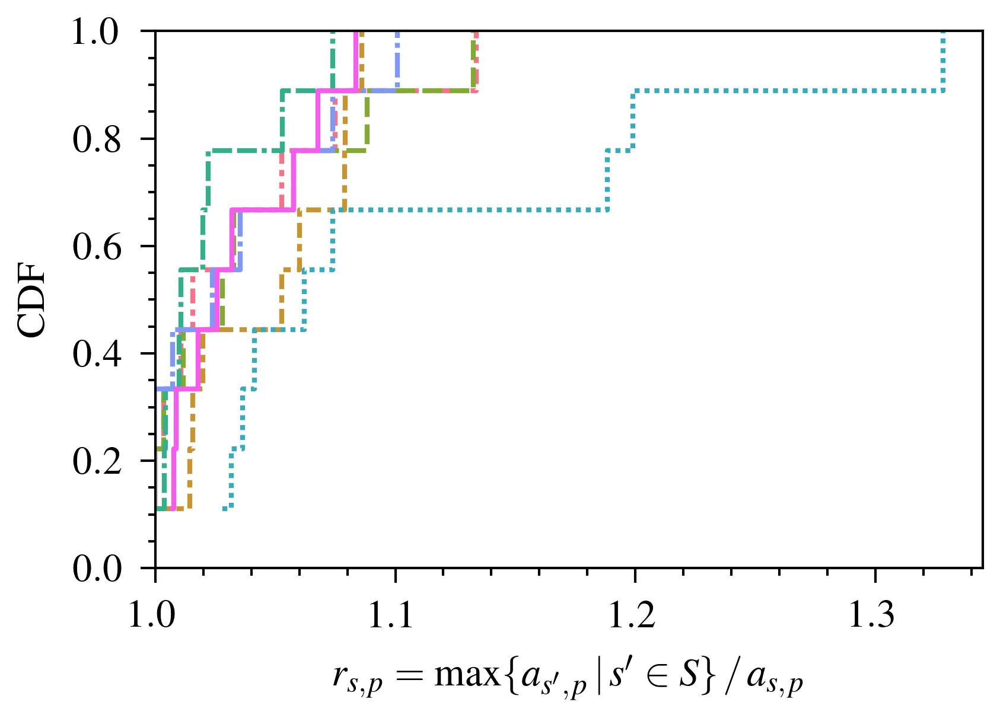

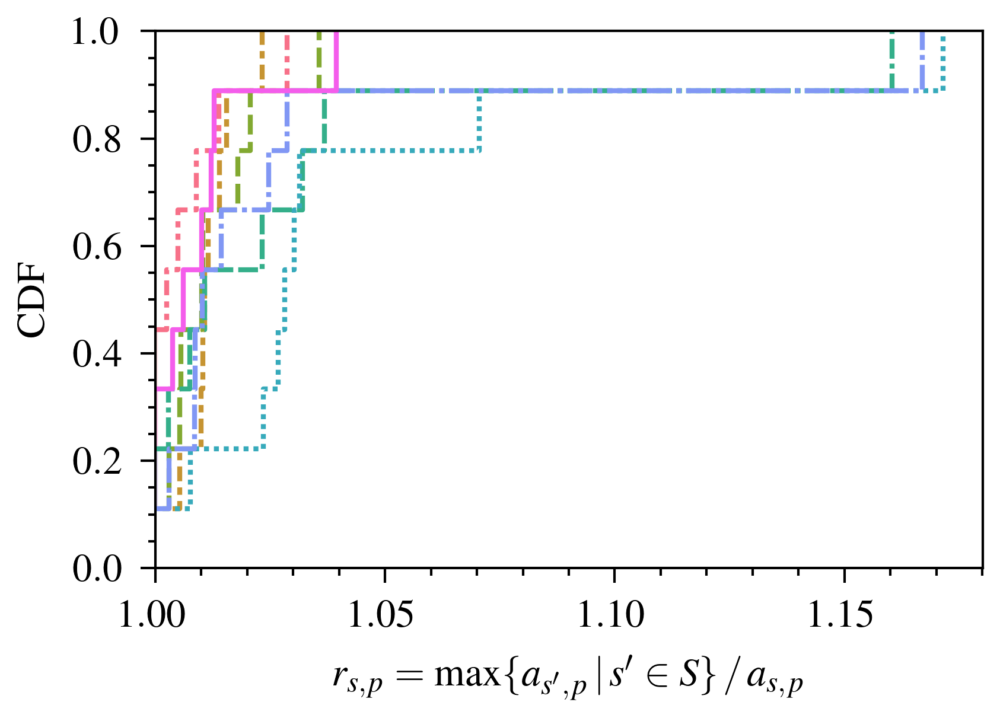

In [21]:
figsize = (3, 2)

dfx = df.copy()
c_2a = dfx["dataset"] == "2a"
c_2b = dfx["dataset"] == "2b"
c_class_nan = dfx["n_classes"].isnull()
c_electrodes_nan = dfx["n_electrodes"].isnull()
c_cross = dfx["intrasession"] != True
dfx.loc[c_2a & c_electrodes_nan, "n_electrodes"] = 22
dfx.loc[c_2a & c_class_nan, "n_classes"] = 4
dfx.loc[c_2b & c_electrodes_nan, "n_electrodes"] = 3
dfx.loc[c_2b & c_class_nan, "n_classes"] = 2
dfx.loc[c_cross, "keep_train"] = 1000

# # BCIC-2a (E=22, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = dfx["dataset"] == "2a"
c2 = dfx["intrasession"] == False
c3 = dfx["n_electrodes"] != 3
c4 = dfx["n_classes"] == 4
c5 = dfx["transform"] != "sliding-window"
data = dfx[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
performance_profile(
    data=data, ax=ax, hue_order=legend_order, legend_labels=legend_labels
)
fig.savefig("../data/ppc_1.pdf", bbox_inches="tight")

# BCIC-2a (E=3, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = dfx["dataset"] == "2a"
c2 = dfx["intrasession"] == False
c3 = dfx["n_electrodes"] == 3
c4 = dfx["n_classes"] == 4
c5 = dfx["transform"] != "sliding-window"
data = dfx[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
performance_profile(data=data, ax=ax, hue_order=legend_order)
fig.savefig("../data/ppc_2.pdf", bbox_inches="tight")

# BCIC-2a (E=22, C=2)
fig, ax = plt.subplots(figsize=figsize)
c1 = dfx["dataset"] == "2a"
c2 = dfx["intrasession"] == False
c3 = dfx["n_electrodes"] == 22
c4 = dfx["n_classes"] == 2
c5 = dfx["transform"] != "sliding-window"
data = dfx[c1 & c2 & c3 & c4 & c5].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36
performance_profile(data=data, ax=ax, hue_order=legend_order)
fig.savefig("../data/ppc_3.pdf", bbox_inches="tight")

# BCIC-2b
fig, ax = plt.subplots(figsize=figsize)
c1 = dfx["dataset"] == "2b"
c2 = dfx["intrasession"] == False
c3 = dfx["transform"] != "sliding-window"
data = dfx[c1 & c2 & c3].copy()
performance_profile(data=data, ax=ax, hue_order=legend_order)
fig.savefig("../data/ppc_4.pdf", bbox_inches="tight")

## Cross-session tables


In [22]:
c1 = df["intrasession"] == False
c2 = df["transform"] != "sliding-window"
data = df[c1 & c2].copy()

c_2a = df["dataset"] == "2a"
c_2b = df["dataset"] == "2b"
c_class_nan = df["n_classes"].isnull()
c_electrodes_nan = df["n_electrodes"].isnull()
data.loc[c_2a & c_electrodes_nan, "n_electrodes"] = 22
data.loc[c_2a & c_class_nan, "n_classes"] = 4
data.loc[c_2b & c_electrodes_nan, "n_electrodes"] = 3
data.loc[c_2b & c_class_nan, "n_classes"] = 2
data.loc[data["session"].isnull(), "session"] = 0
data.loc[data["keep_train"].isnull(), "keep_train"] = 1000

kb = statistical_test_alt(data, correction_size=6 * 4)
kb = kb.pivot_table(index="transform", columns=["n_classes", "n_electrodes", "dataset"])
kb = kb.sort_index(axis=1, ascending=[False, False, False, True])

data = (
    data.groupby(["transform", "dataset", "n_electrodes", "n_classes"])["test_accuracy"]
    .describe()
    .reset_index()
)
data["mean_std"] = data.apply(
    lambda row: f"{round(row['mean'], 3):.3f} $\pm$ {round(row['std'], 3):.3f}",
    axis=1,
)
data = data[["dataset", "n_electrodes", "n_classes", "transform", "mean_std"]]
table = pd.pivot_table(
    data,
    values="mean_std",
    index="transform",
    columns=["n_classes", "n_electrodes", "dataset"],
    aggfunc="first",
).reindex(table_order)
table = table.sort_index(axis=1, level=0, ascending=False)
table.index = table_labels
table = table.apply(bold_best, axis=0)
with pd.option_context("max_colwidth", 10000):
    print(table.to_latex(escape=False))

kb


\begin{tabular}{lllll}
\toprule
n_classes & \multicolumn{2}{l}{4.0} & \multicolumn{2}{l}{2.0} \\
n_electrodes &                        22.0 &                        3.0  &                        22.0 &                        3.0  \\
dataset &                          2a &                          2a &                          2a &                          2b \\
\midrule
Baseline &           0.696 $\pm$ 0.146 &           0.566 $\pm$ 0.113 &           0.798 $\pm$ 0.153 &           0.762 $\pm$ 0.142 \\
SW       &  \textbf{0.708 $\pm$ 0.148} &  \textbf{0.574 $\pm$ 0.117} &           0.797 $\pm$ 0.153 &  \textbf{0.764 $\pm$ 0.142} \\
NA       &           0.688 $\pm$ 0.150 &           0.562 $\pm$ 0.116 &           0.791 $\pm$ 0.160 &           0.761 $\pm$ 0.144 \\
AP       &           0.690 $\pm$ 0.149 &           0.565 $\pm$ 0.118 &           0.794 $\pm$ 0.153 &           0.760 $\pm$ 0.145 \\
SR       &           0.705 $\pm$ 0.152 &           0.573 $\pm$ 0.119 &  \textbf{0.808 $\pm$ 0.153} 

pvalue                             
n_classes                         4                  2          
n_electrodes                     22       3         22        3 
dataset                          2a       2a        2a        2b
transform                                                       
Baseline                   1.000000  1.00000  1.000000  1.000000
amplitude-perturbation-15  1.000000  1.00000  1.000000  1.000000
emd                        0.000321  0.70106  0.007096  0.172172
gaussian                   1.000000  1.00000  1.000000  1.000000
sliding-recombination      1.000000  1.00000  1.000000  1.000000
sliding-window-x           1.000000  1.00000  1.000000  1.000000
stft-recombination         1.000000  1.00000  1.000000  1.000000

## Cross-session graphs


In [23]:
def subject_plot(data, ax, legends=False):
    transforms = []
    for subject in range(1, 9 + 1):
        c_subject = data["subject"] == subject
        c_transform = data["transform"] != "Baseline"
        group = (
            data[c_subject & c_transform]
            .groupby("transform")["test_accuracy"]
            .mean()
            .to_frame()
        )
        transforms.append(group.idxmax()[0])

    conditions = data["transform"] == "Baseline"
    for subject, transform in enumerate(transforms):
        subject += 1
        conditions = conditions | (
            (data["transform"] == transform) & (data["subject"] == subject)
        )

    data = data[conditions].copy()
    data["is_augmented"] = data["transform"] != "Baseline"
    sns.barplot(
        data=data,
        x="subject",
        y="test_accuracy",
        hue="is_augmented",
        ci="sd",
        ax=ax,
        errwidth=0.25,
        capsize=0.25,
    )

    ax.set_xlabel("Subject ID")
    ax.set_ylabel("Accuracy")
    ax.set_xticks([], minor=True)

    if legends:
        handles = ax.get_legend().legendHandles
        ax.legend(
            handles,
            ["Baseline", "Augmented"],
            ncol=1,
            loc="upper center",
            bbox_to_anchor=(0.5, 1.025),
        )
    else:
        ax.get_legend().remove()

    for line in ax.get_lines():
        line.set_linestyle("-")

    return data

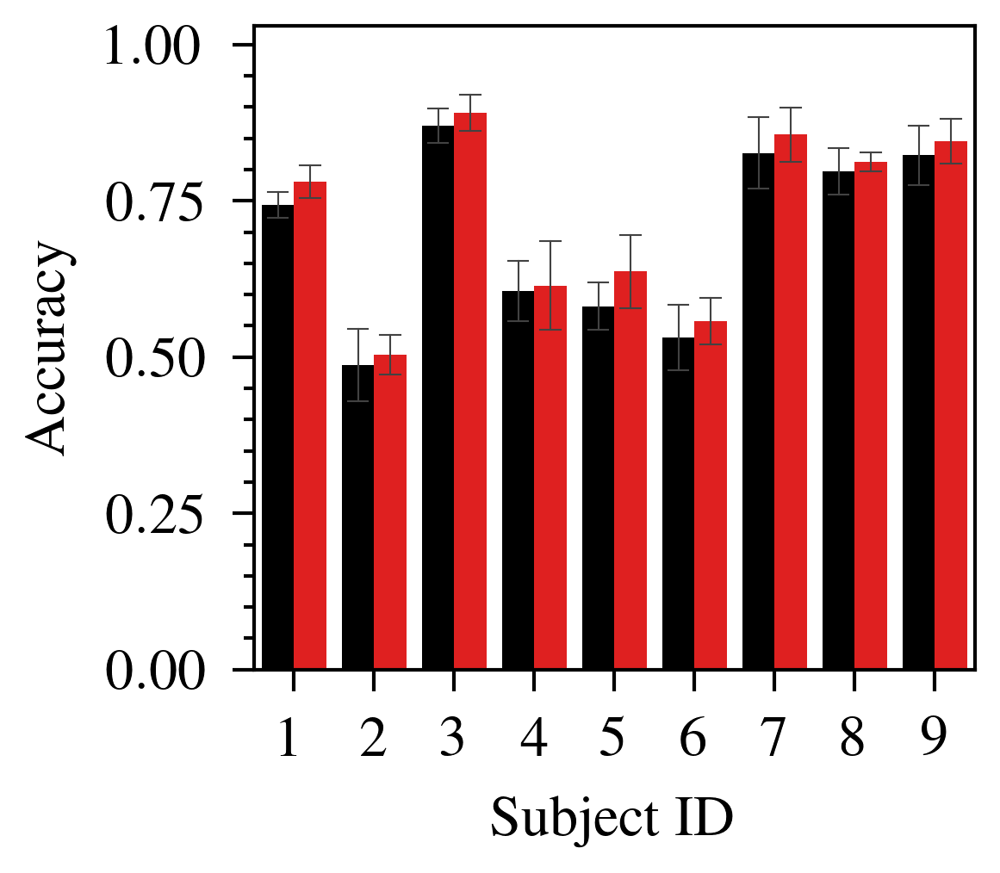

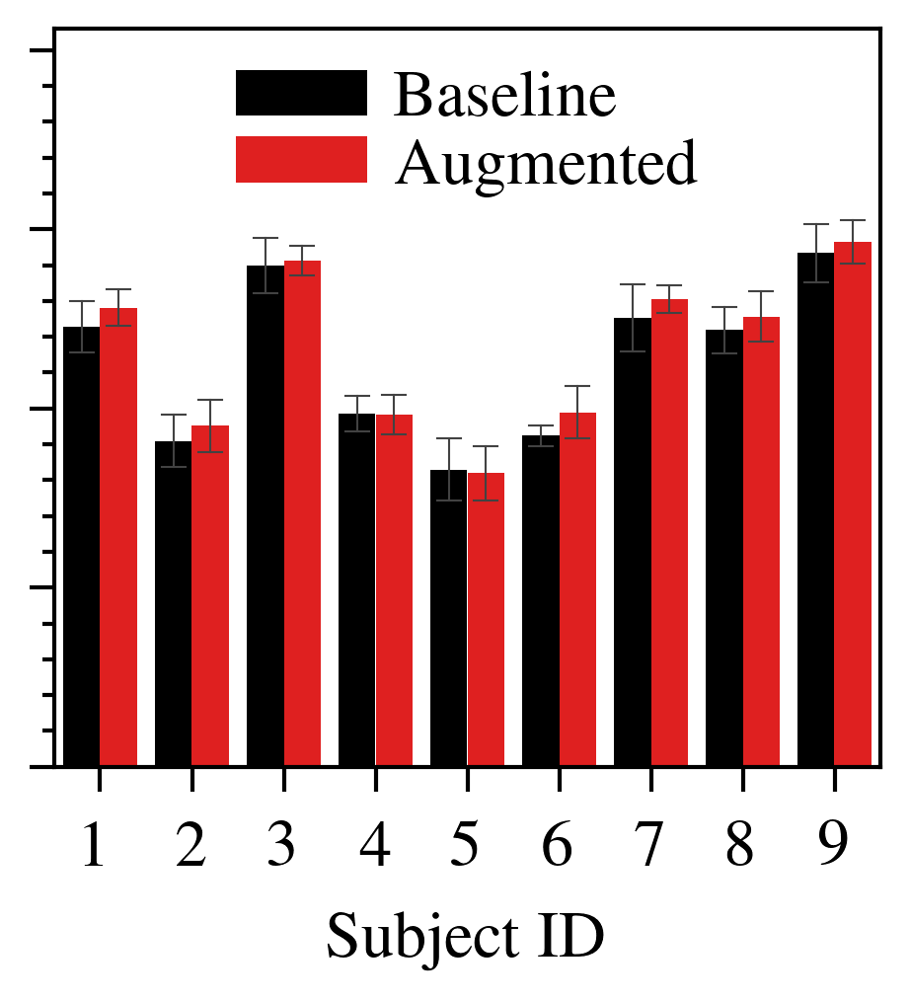

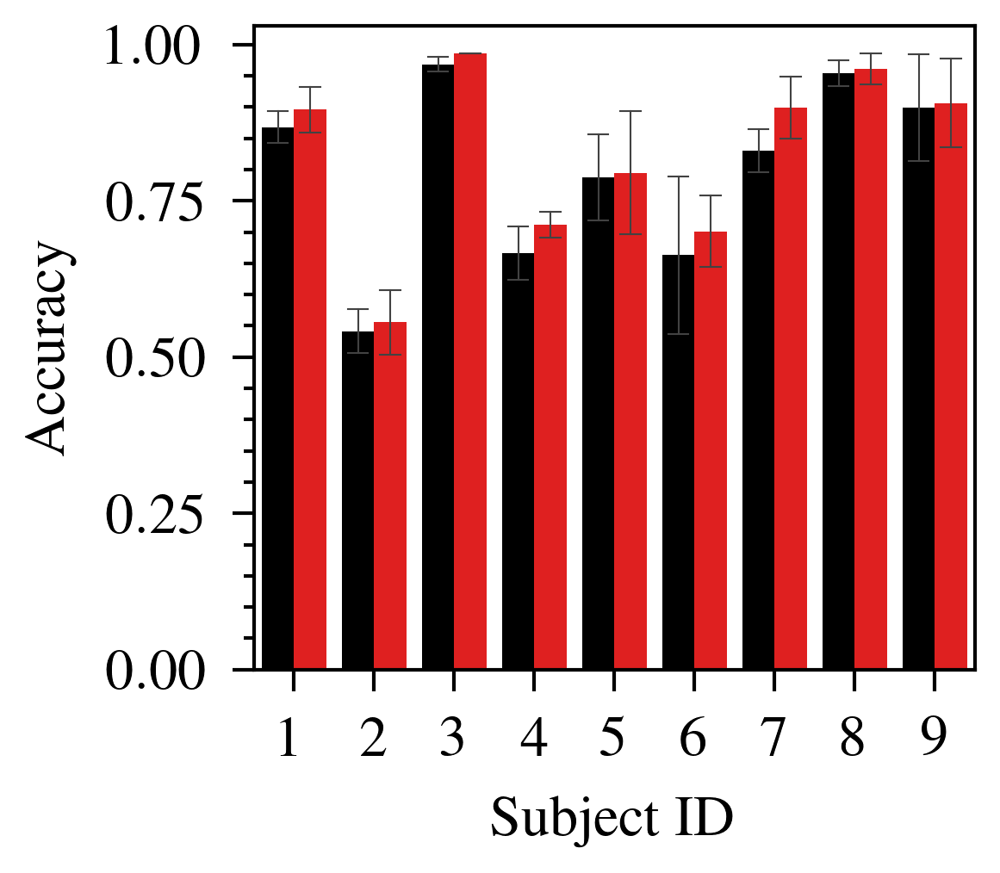

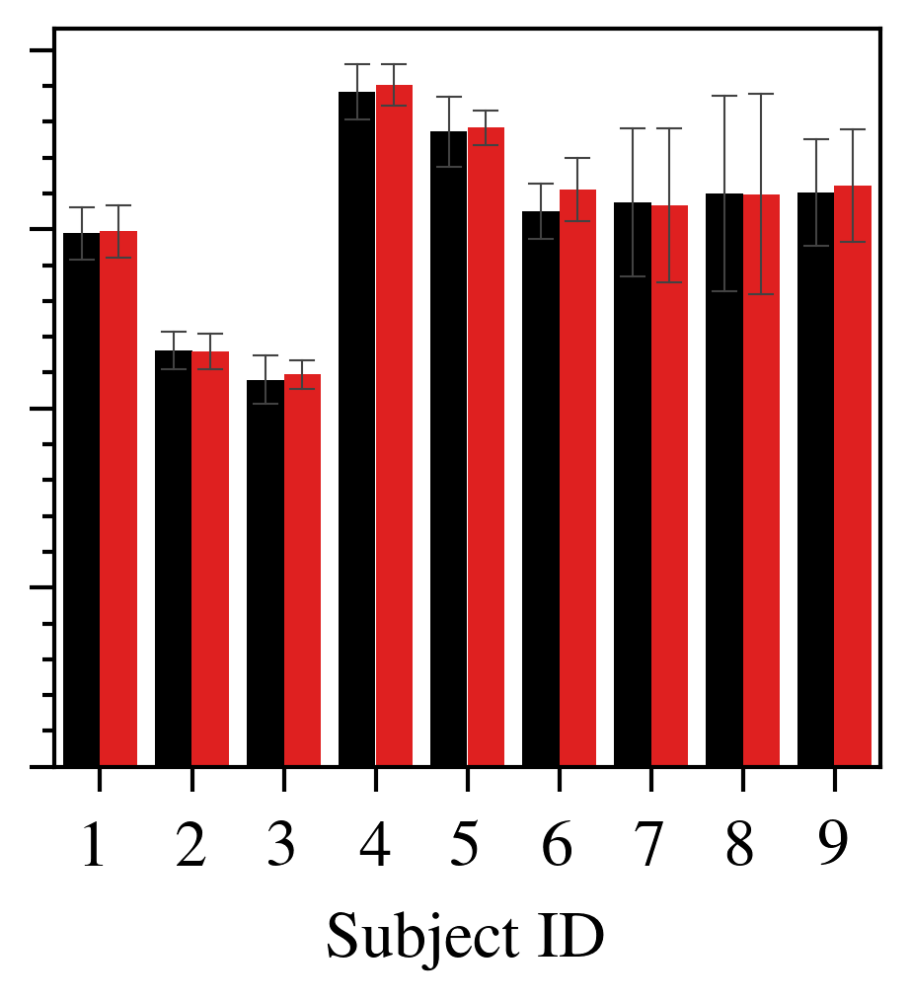

In [24]:
figsize = (1.8, 1.65)

# BCIC-2a (E=22, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == False
c3 = df["n_electrodes"] != 3
c4 = df["n_classes"] != 2
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
subject_plot(data, ax=ax, legends=False)
ax.set_ylim(0.0, 1.029791200099394)
fig.savefig("../data/bar_1.pdf", bbox_inches="tight")

# # BCIC-2a (E=3, C=4)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == False
c3 = df["n_electrodes"] == 3
c4 = df["n_classes"] == 4
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
subject_plot(data, ax=ax, legends=True)
ax.set_ylabel(None)
ax.set_yticklabels([])
ax.set_ylim(0.0, 1.029791200099394)
fig.savefig("../data/bar_2.pdf", bbox_inches="tight")

# # BCIC-2a (E=22, C=2)
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == False
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 2
c5 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3 & c4 & c5].copy()
subject_plot(data, ax=ax, legends=False)
ax.set_ylim(0.0, 1.029791200099394)
fig.savefig("../data/bar_3.pdf", bbox_inches="tight")

# # BCIC-2b
fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2b"
c2 = df["intrasession"] == False
c3 = df["transform"] != "sliding-window"
data = df[c1 & c2 & c3].copy()
subject_plot(data, ax=ax, legends=False)
ax.set_ylabel(None)
ax.set_yticklabels([])
ax.set_ylim(0.0, 1.029791200099394)
fig.savefig("../data/bar_4.pdf", bbox_inches="tight")

## Time


In [25]:
# Because the file is too large, it hasn't been included in the repository.
# You can download it from the link https://drive.google.com/file/d/152dnBfciU1M0pbjrIP20VVo02prpssb-/view?usp=sharing
df_history = pd.read_parquet("../data/training_history.parquet")
df_history = df_history.join(
    df[
        [
            "name",
            "dataset",
            "n_electrodes",
            "n_classes",
            "intrasession",
            "keep_train",
            "transform",
        ]
    ].set_index("name"),
    on="name",
)
df_history

,name,_step,_timestamp,dur,train_accuracy,train_loss,valid_accuracy,valid_loss,dataset,n_electrodes,n_classes,intrasession,keep_train,transform
0,laced-plant-19301,0,1643413707,0.020624,0.472222,0.693380,0.500000,0.692936,NaN,NaN,NaN,NaN,NaN,NaN
1,laced-plant-19301,1,1643413707,0.016452,0.611111,0.678925,0.555556,0.692887,NaN,NaN,NaN,NaN,NaN,NaN
2,laced-plant-19301,2,1643413707,0.016299,0.569444,0.671024,0.555556,0.692829,NaN,NaN,NaN,NaN,NaN,NaN
3,laced-plant-19301,3,1643413707,0.016479,0.555556,0.658742,0.500000,0.692757,NaN,NaN,NaN,NaN,NaN,NaN
4,laced-plant-19301,4,1643413707,0.016144,0.541667,0.655962,0.500000,0.692682,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17243995,comic-monkey-6,495,1642331790,0.040607,0.986111,0.301933,0.763889,0.606233,2a,22.0,4.0,False,NaN,Baseline
17243996,comic-monkey-6,496,1642331790,0.047745,0.986111,0.238666,0.784722,0.570124,2a,22.0,4.0,False,NaN,Baseline
17243997,comic-monkey-6,497,1642331790,0.041513,0.979167,0.236182,0.729167,0.610421,2a,22.0,4.0,False,NaN,Baseline
17243998,comic-monkey-6,498,1642331790,0.041938,0.979167,0.261241,0.756944,0.598957,2a,22.0,4.0,False,NaN,Baseline


### Mean Curve

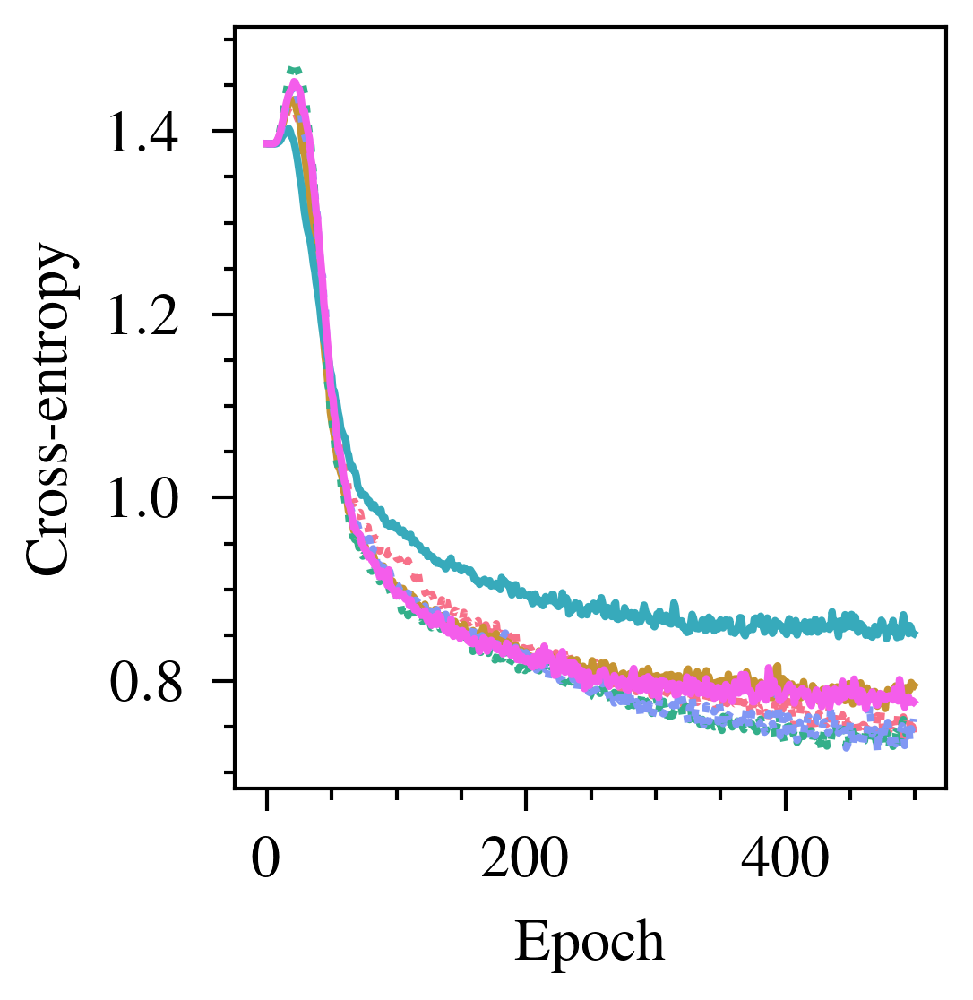

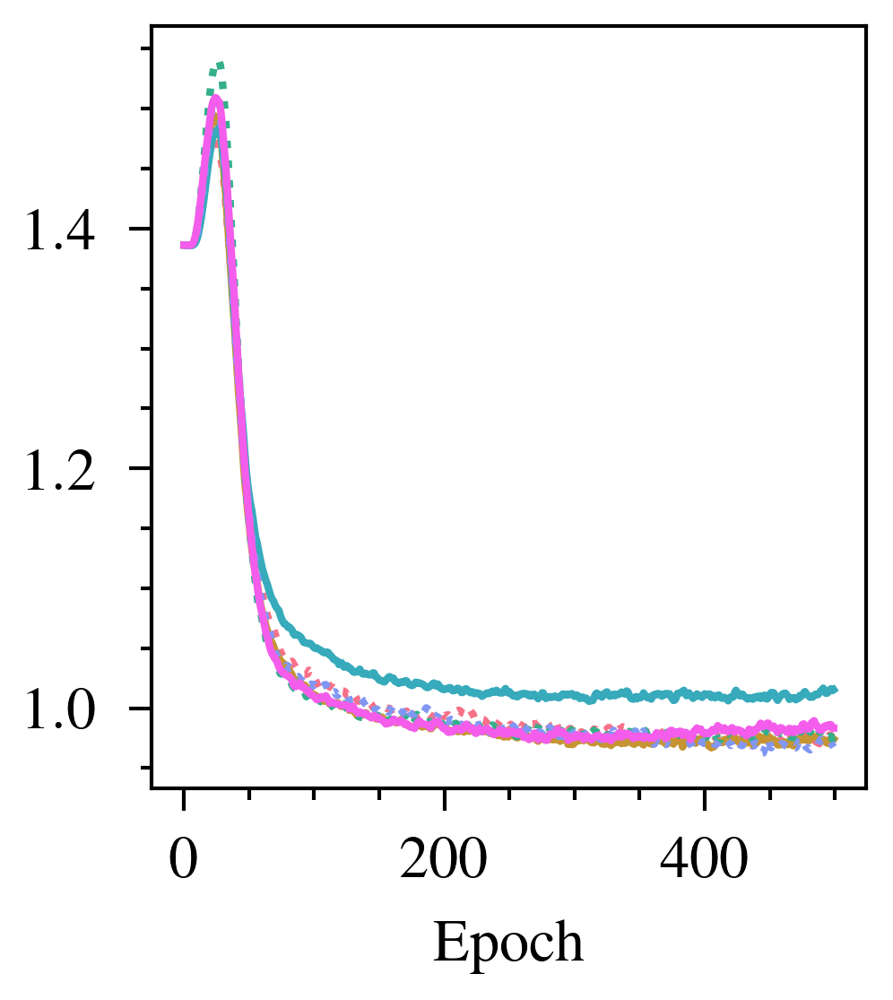

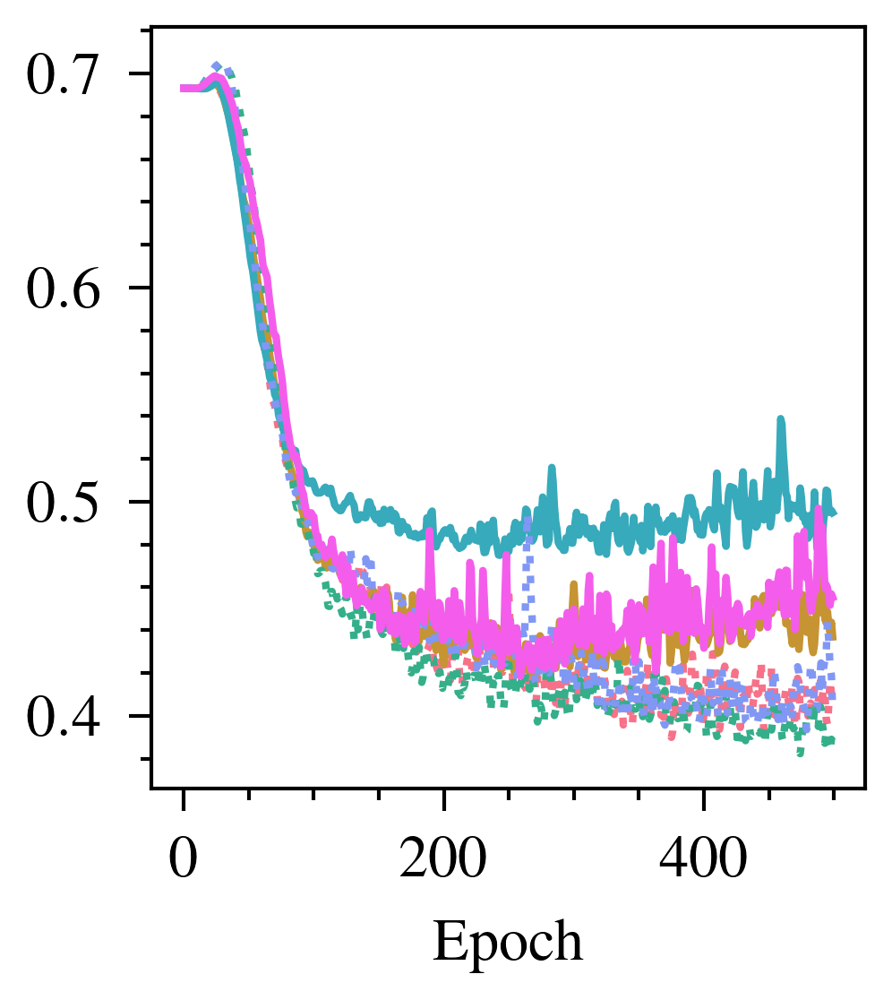

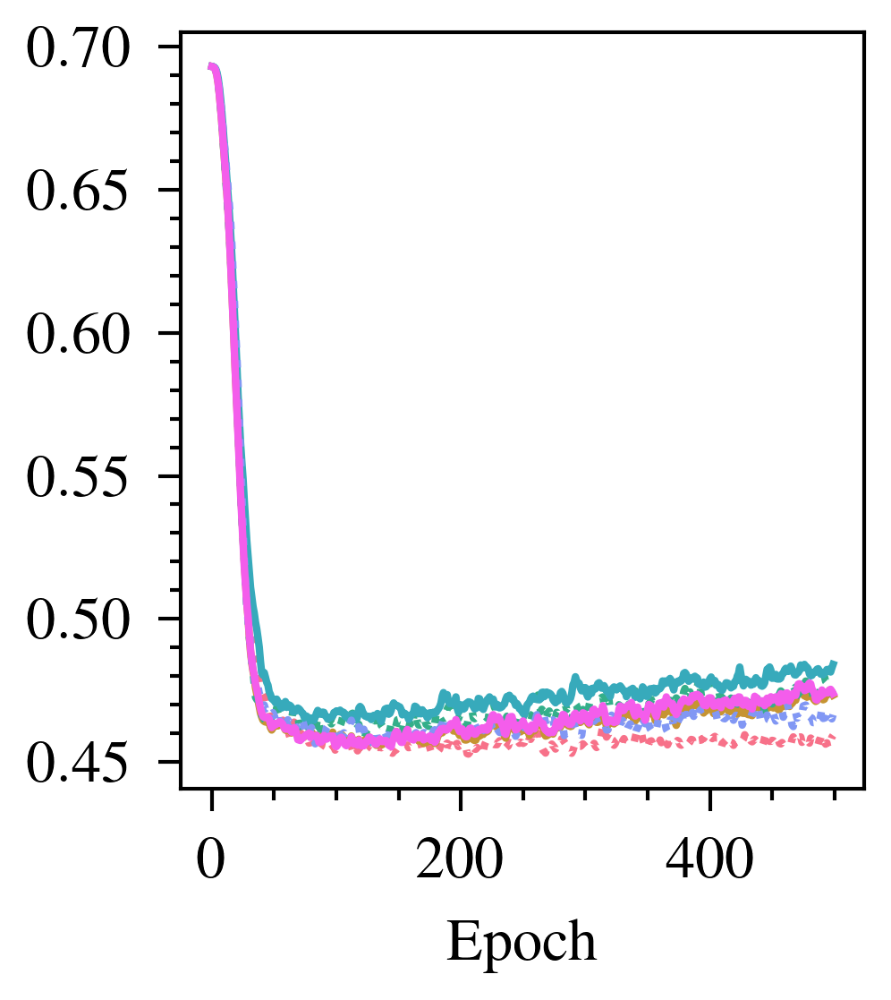

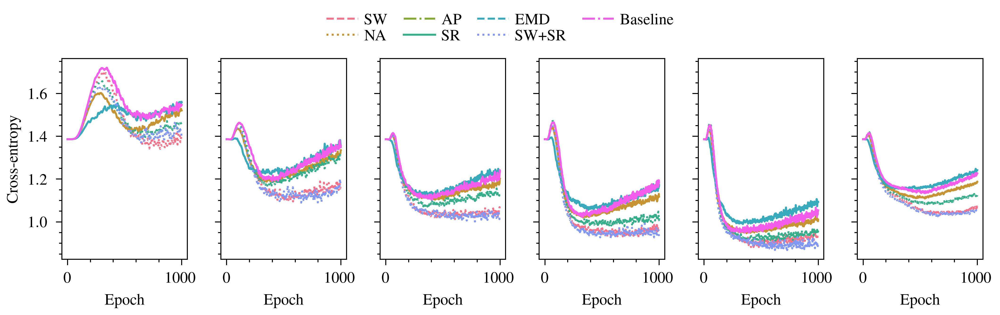

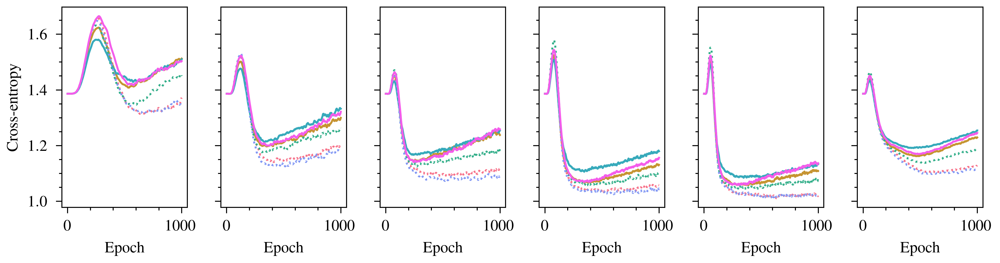

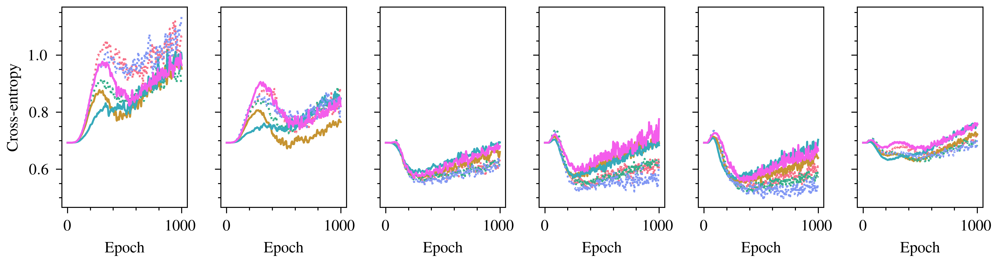

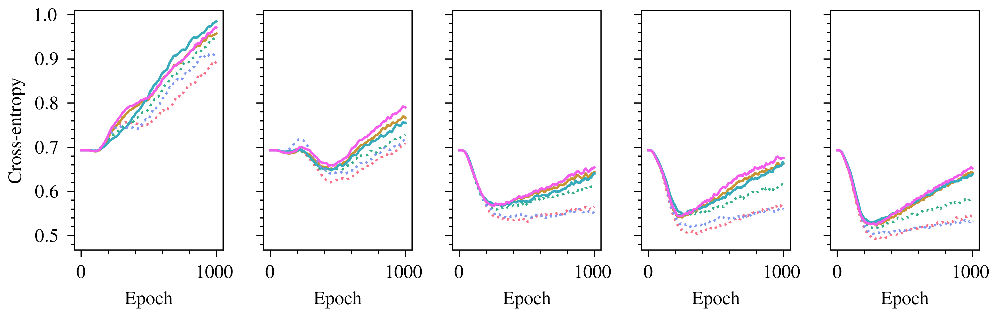

In [26]:
c_within = df_history["intrasession"] == False

# cross-session
dataset = [
    ("2a", 22, 4, [None]),
    ("2a", 3, 4, [None]),
    ("2a", 22, 2, [None]),
    ("2b", 3, 2, [None]),
]
for i, (ds, el, cl, kt) in enumerate(dataset):
    fig, ax = plt.subplots(
        figsize=(1.8 + (0.15 if i == 0 else 0), 2),
    )
    for j, k in enumerate(kt):
        c_dataset = df_history["dataset"] == ds
        c_electrodes = df_history["n_electrodes"] == el
        c_classes = df_history["n_classes"] == cl
        if k is not None:
            c_size = df_history["keep_train"] == k
        else:
            c_size = df_history["keep_train"].apply(lambda _: True)
        data = df_history[c_within & c_size & c_dataset & c_electrodes & c_classes].copy()
        g = sns.lineplot(
            data=data,
            x="_step",
            y="valid_loss",
            hue="transform",
            hue_order=legend_order,
            estimator="mean",
            ci=None,
            ax=ax,
        )
        g.get_legend().remove()
        g.set_xlabel("Epoch")
        if i == 0:
            g.set_ylabel("Cross-entropy")
        else:
            g.set_ylabel(None)
    fig.tight_layout()
    fig.savefig(f"../data/mean_loss_cross_{i}.pdf", bbox_inches="tight")

# within-session
dataset = [
    ("2a", 22, 4, [6, 12, 18, 24, 30, None]),
    ("2a", 3, 4, [6, 12, 18, 24, 30, None]),
    ("2a", 22, 2, [6, 12, 18, 24, 30, None]),
    ("2b", 3, 2, [6, 12, 18, 24, 30]),
]
for i, (ds, el, cl, kt) in enumerate(dataset):
    fig, ax = plt.subplots(
        figsize=(len(kt) * 1.2, 2),
        nrows=1,
        ncols=len(kt),
        squeeze=True,
        sharex=True,
        sharey="row",
    )
    for j, k in enumerate(kt):
        c_dataset = df_history["dataset"] == ds
        c_electrodes = df_history["n_electrodes"] == el
        c_classes = df_history["n_classes"] == cl
        if k is not None:
            c_size = df_history["keep_train"] == k
        else:
            c_size = df_history["keep_train"].apply(lambda _: True)
        
        data = df_history[~c_within & c_size & c_dataset & c_electrodes & c_classes].copy()
        g = sns.lineplot(
            data=data,
            x="_step",
            y="valid_loss",
            hue="transform",
            hue_order=legend_order,
            estimator="mean",
            ci=None,
            ax=ax[j],
        )
        if i == 0 and j == 0:
            handles, labels = g.get_legend_handles_labels()
            fig.legend(
                handles,
                legend_labels,
                title=None,
                loc="upper center",
                ncol=4,
                bbox_to_anchor=(0.5, 1.15)
            )
        g.get_legend().remove()
        if j == 0:
            g.set_ylabel("Cross-entropy")
        else:
            g.set_ylabel(None)
        g.set_xlabel("Epoch")
    fig.tight_layout()
    fig.savefig(f"../data/mean_loss_within_{i}.pdf", bbox_inches="tight")

### KDE

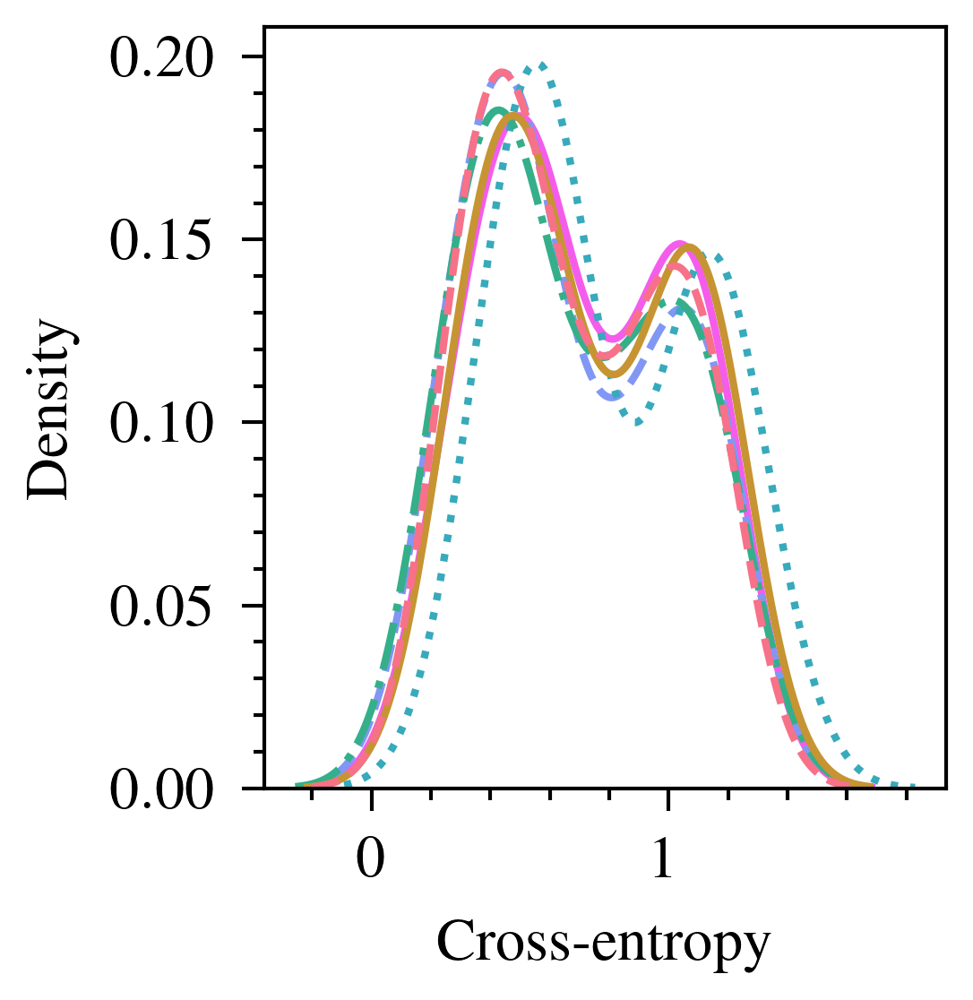

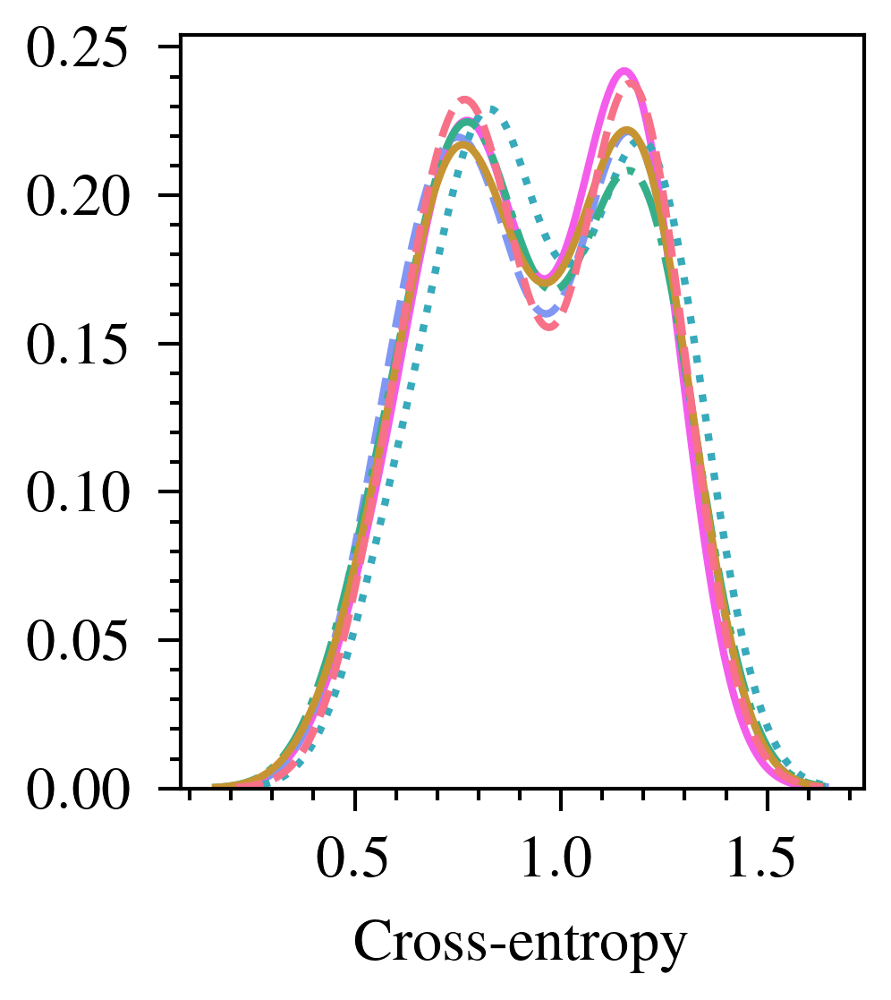

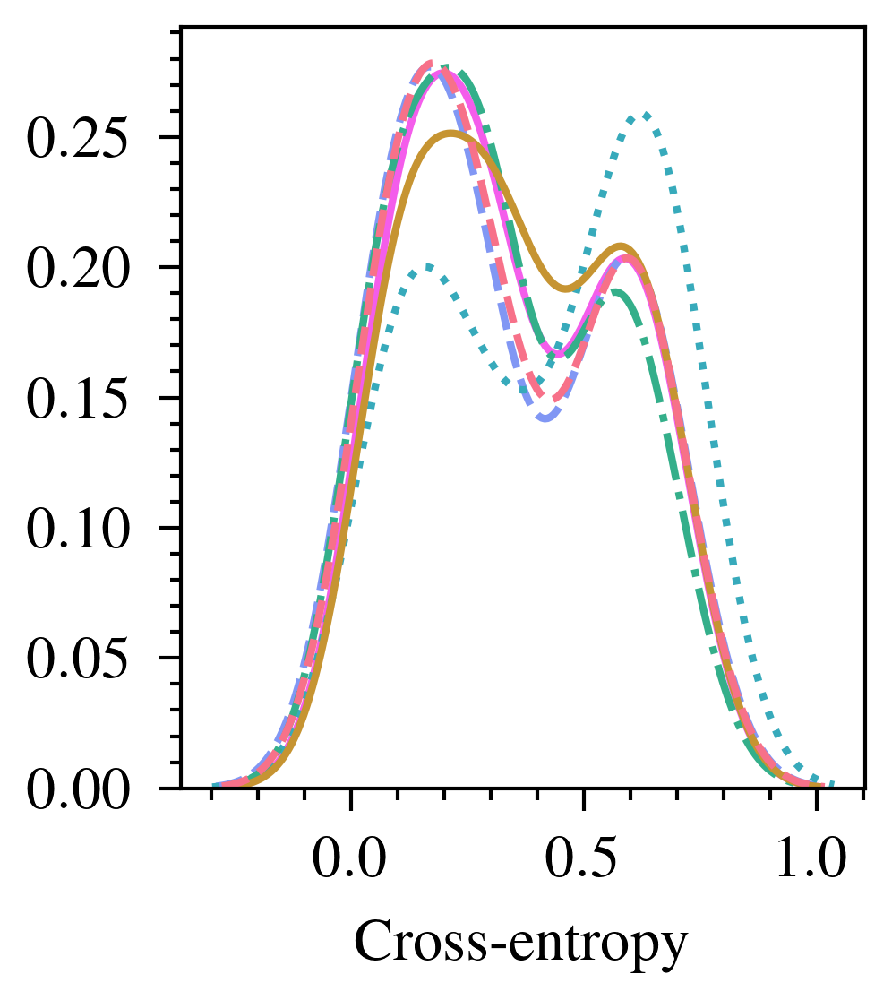

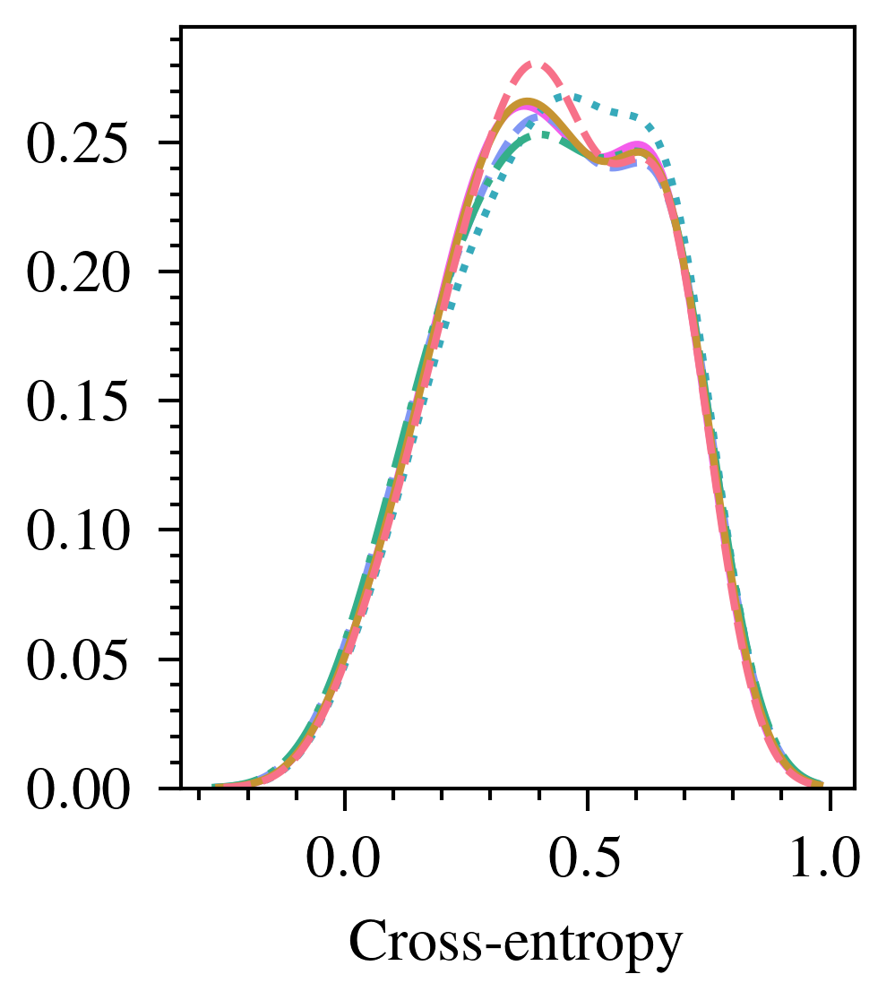

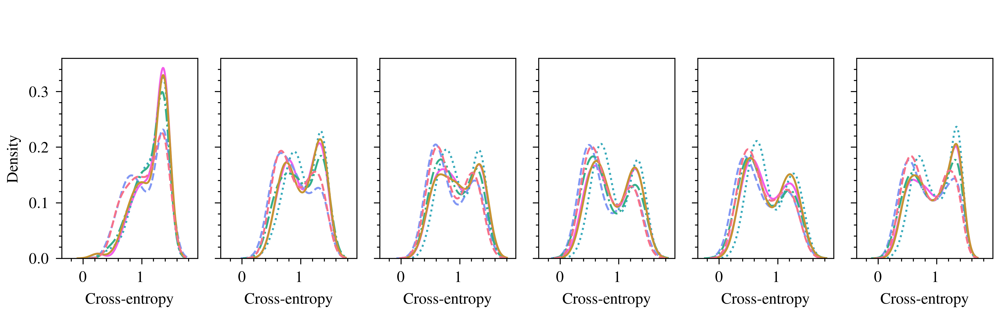

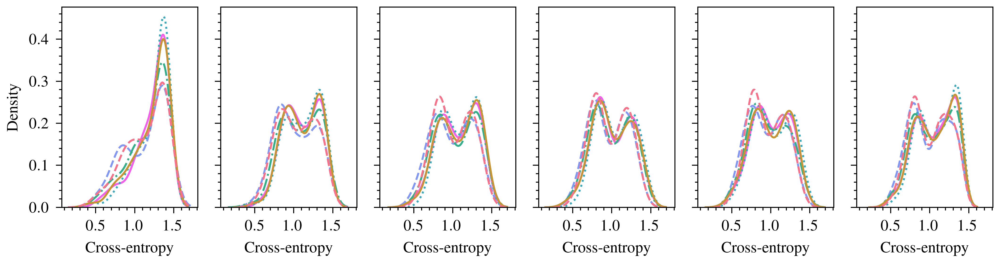

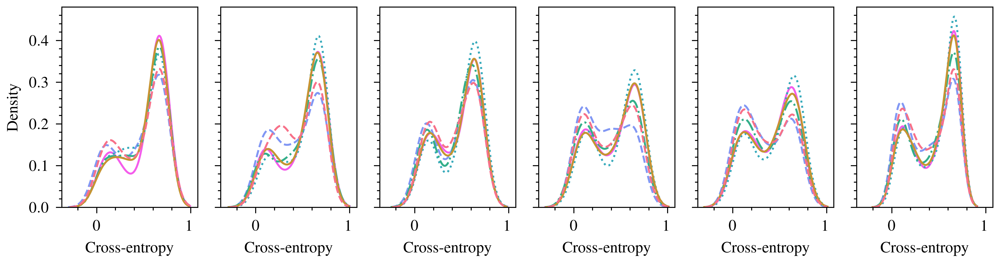

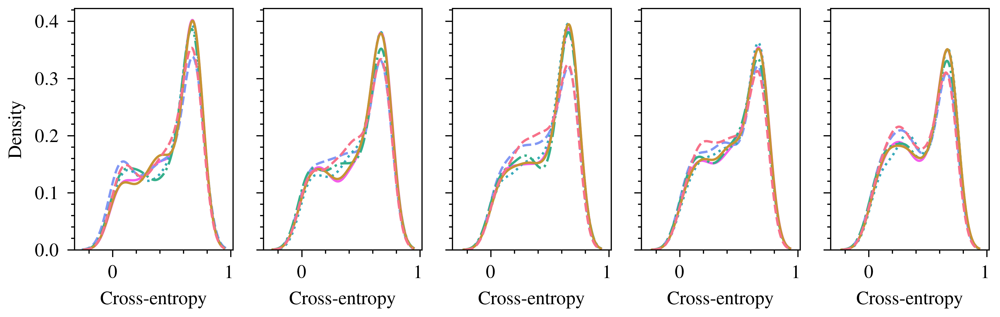

In [39]:
c_within = df_history["intrasession"] == False

# cross-session
dataset = [
    ("2a", 22, 4, [None]),
    ("2a", 3, 4, [None]),
    ("2a", 22, 2, [None]),
    ("2b", 3, 2, [None]),
]
for i, (ds, el, cl, kt) in enumerate(dataset):
    fig, ax = plt.subplots(
        figsize=(1.8 + (0.15 if i == 0 else 0), 2),
    )
    for j, k in enumerate(kt):
        c_dataset = df_history["dataset"] == ds
        c_electrodes = df_history["n_electrodes"] == el
        c_classes = df_history["n_classes"] == cl
        if k is not None:
            c_size = df_history["keep_train"] == k
        else:
            c_size = df_history["keep_train"].apply(lambda _: True)
        data = df_history[c_within & c_size & c_dataset & c_electrodes & c_classes].copy()
        data = data.loc[data.groupby("name")["valid_loss"].idxmin()]
        g = sns.kdeplot(
            data=data,
            x="valid_loss",
            hue="transform",
            hue_order=legend_order,
            ax=ax,
        )
        g.get_legend().remove()
        g.set_xlabel("Cross-entropy")
        if i == 0:
            g.set_ylabel("Density")
        else:
            g.set_ylabel(None)
    fig.tight_layout()
    fig.savefig(f"../data/kde_loss_cross_{i}.pdf", bbox_inches="tight")

# within-session
dataset = [
    ("2a", 22, 4, [6, 12, 18, 24, 30, None]),
    ("2a", 3, 4, [6, 12, 18, 24, 30, None]),
    ("2a", 22, 2, [6, 12, 18, 24, 30, None]),
    ("2b", 3, 2, [6, 12, 18, 24, 30]),
]
for i, (ds, el, cl, kt) in enumerate(dataset):
    fig, ax = plt.subplots(
        figsize=(len(kt) * 1.2, 2),
        nrows=1,
        ncols=len(kt),
        squeeze=True,
        sharex=True,
        sharey="row",
    )
    for j, k in enumerate(kt):
        c_dataset = df_history["dataset"] == ds
        c_electrodes = df_history["n_electrodes"] == el
        c_classes = df_history["n_classes"] == cl
        if k is not None:
            c_size = df_history["keep_train"] == k
        else:
            c_size = df_history["keep_train"].apply(lambda _: True)
        
        data = df_history[~c_within & c_size & c_dataset & c_electrodes & c_classes].copy()
        data = data.loc[data.groupby("name")["valid_loss"].idxmin()]
        g = sns.kdeplot(
            data=data,
            x="valid_loss",
            hue="transform",
            hue_order=legend_order,
            ax=ax[j],
        )
        if i == 0 and j == 0:
            handles, labels = g.get_legend_handles_labels()
            fig.legend(
                handles,
                legend_labels,
                title=None,
                loc="upper center",
                ncol=4,
                bbox_to_anchor=(0.5, 1.15)
            )
        g.get_legend().remove()
        if j == 0:
            g.set_ylabel("Density")
        else:
            g.set_ylabel(None)
        g.set_xlabel("Cross-entropy")
    fig.tight_layout()
    fig.savefig(f"../data/kde_loss_within_{i}.pdf", bbox_inches="tight")

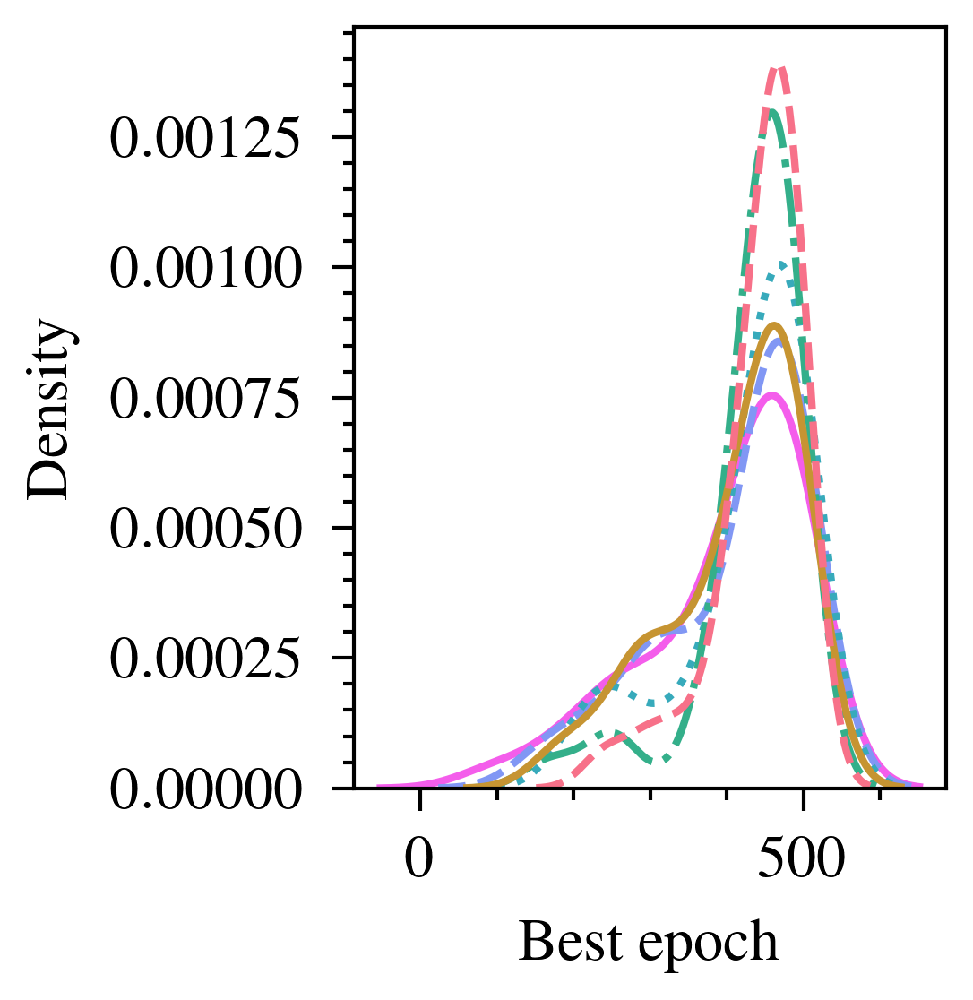

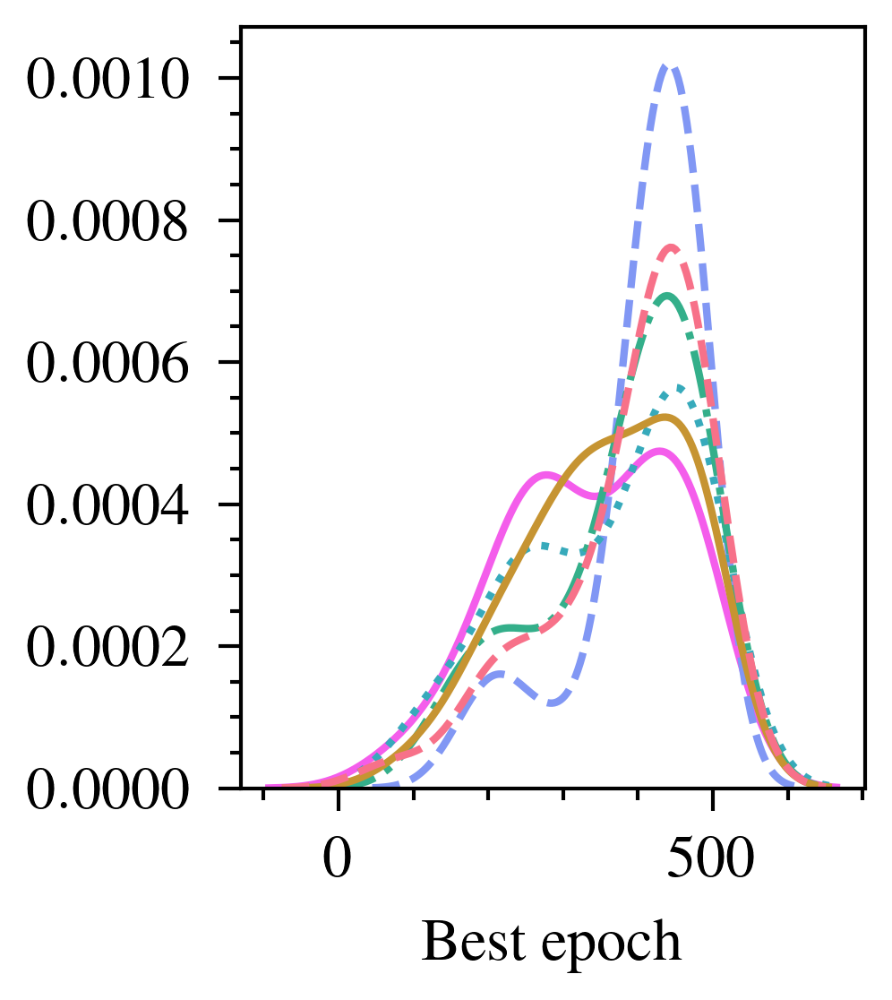

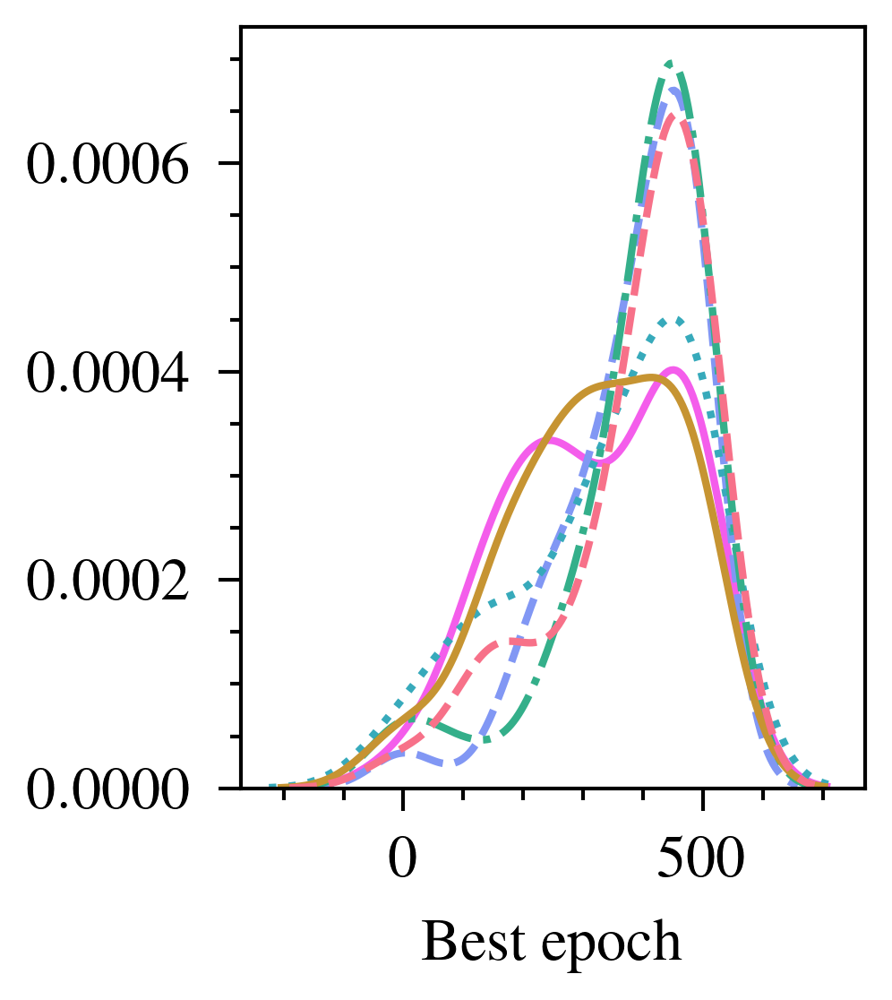

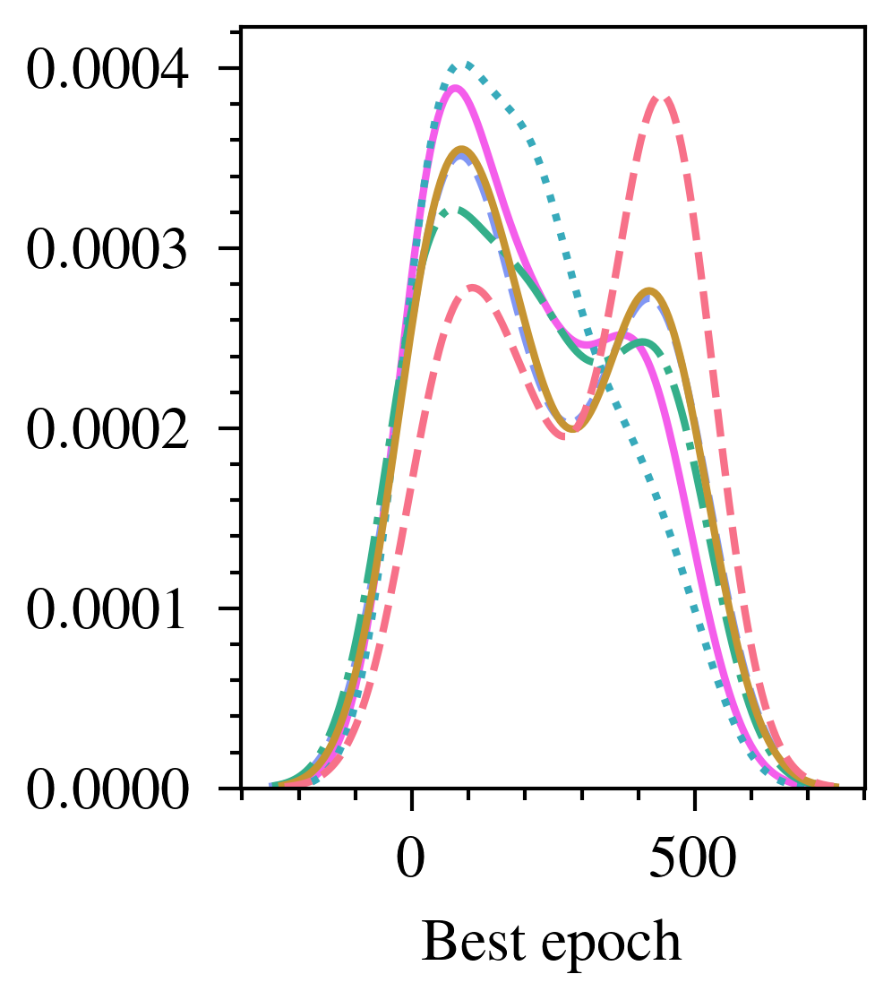

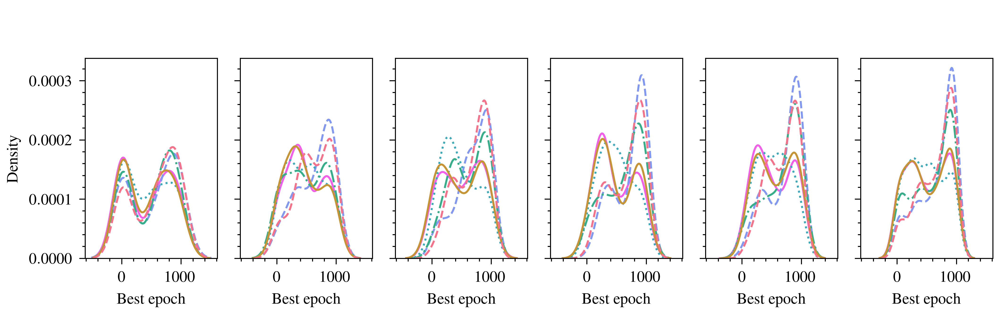

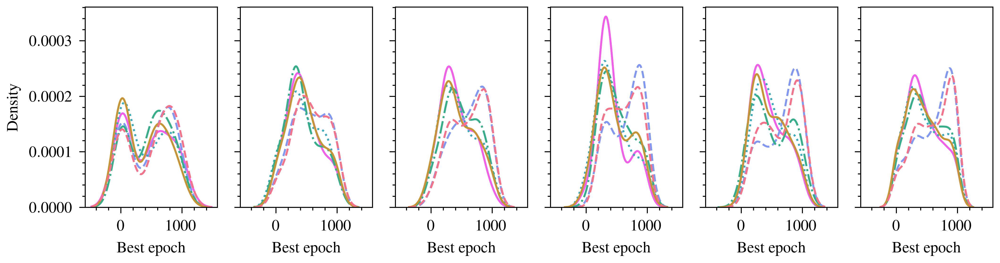

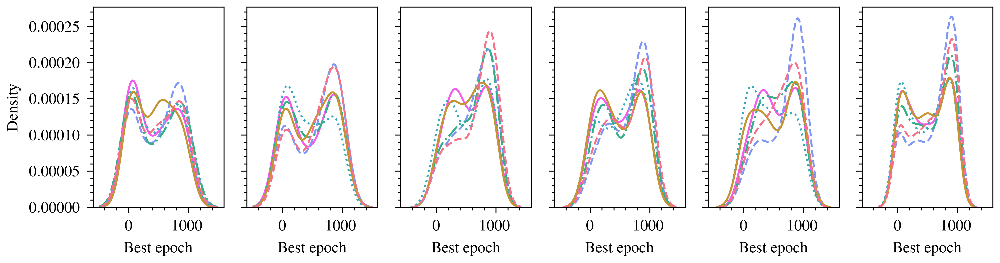

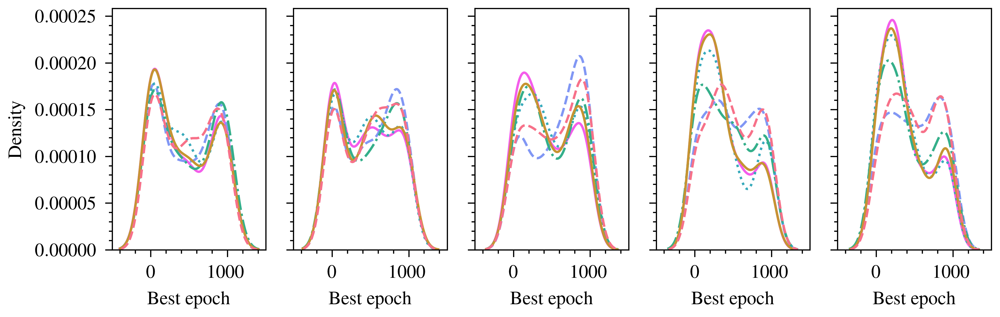

In [40]:
c_within = df_history["intrasession"] == False

# cross-session
dataset = [
    ("2a", 22, 4, [None]),
    ("2a", 3, 4, [None]),
    ("2a", 22, 2, [None]),
    ("2b", 3, 2, [None]),
]
for i, (ds, el, cl, kt) in enumerate(dataset):
    fig, ax = plt.subplots(
        figsize=(1.8 + (0.15 if i == 0 else 0), 2),
    )
    for j, k in enumerate(kt):
        c_dataset = df_history["dataset"] == ds
        c_electrodes = df_history["n_electrodes"] == el
        c_classes = df_history["n_classes"] == cl
        if k is not None:
            c_size = df_history["keep_train"] == k
        else:
            c_size = df_history["keep_train"].apply(lambda _: True)
        data = df_history[c_within & c_size & c_dataset & c_electrodes & c_classes].copy()
        data = data.loc[data.groupby("name")["valid_loss"].idxmin()]
        g = sns.kdeplot(
            data=data,
            x="_step",
            hue="transform",
            hue_order=legend_order,
            ax=ax,
        )
        g.get_legend().remove()
        g.set_xlabel("Best epoch")
        if i == 0:
            g.set_ylabel("Density")
        else:
            g.set_ylabel(None)
    fig.tight_layout()
    fig.savefig(f"../data/kde_step_cross_{i}.pdf", bbox_inches="tight")

# within-session
dataset = [
    ("2a", 22, 4, [6, 12, 18, 24, 30, None]),
    ("2a", 3, 4, [6, 12, 18, 24, 30, None]),
    ("2a", 22, 2, [6, 12, 18, 24, 30, None]),
    ("2b", 3, 2, [6, 12, 18, 24, 30]),
]
for i, (ds, el, cl, kt) in enumerate(dataset):
    fig, ax = plt.subplots(
        figsize=(len(kt) * 1.2, 2),
        nrows=1,
        ncols=len(kt),
        squeeze=True,
        sharex=True,
        sharey="row",
    )
    for j, k in enumerate(kt):
        c_dataset = df_history["dataset"] == ds
        c_electrodes = df_history["n_electrodes"] == el
        c_classes = df_history["n_classes"] == cl
        if k is not None:
            c_size = df_history["keep_train"] == k
        else:
            c_size = df_history["keep_train"].apply(lambda _: True)
        
        data = df_history[~c_within & c_size & c_dataset & c_electrodes & c_classes].copy()
        data = data.loc[data.groupby("name")["valid_loss"].idxmin()]
        g = sns.kdeplot(
            data=data,
            x="_step",
            hue="transform",
            hue_order=legend_order,
            ax=ax[j],
        )
        if i == 0 and j == 0:
            handles, labels = g.get_legend_handles_labels()
            fig.legend(
                handles,
                legend_labels,
                title=None,
                loc="upper center",
                ncol=4,
                bbox_to_anchor=(0.5, 1.15)
            )
        g.get_legend().remove()
        if j == 0:
            g.set_ylabel("Density")
        else:
            g.set_ylabel(None)
        g.set_xlabel("Best epoch")
    fig.tight_layout()
    fig.savefig(f"../data/kde_step_within_{i}.pdf", bbox_inches="tight")

## EMD


In [ ]:
def subject_plot_emd(data, ax, legends=False):
    # data = data[data["keep_train"] == 6]
    conditions = data["transform"] == "Baseline"
    for subject in range(9):
        subject += 1
        conditions = conditions | (
            (data["transform"] == "emd") & (data["subject"] == subject)
        )

    data = data[conditions].copy()
    data["is_augmented"] = data["transform"] != "Baseline"
    sns.barplot(
        data=data,
        x="subject",
        y="test_accuracy",
        hue="is_augmented",
        ci="sd",
        ax=ax,
        errwidth=0.25,
        capsize=0.25,
    )

    ax.set_xlabel("Subject ID")
    ax.set_ylabel("Accuracy")
    ax.set_xticks([], minor=True)

    if legends:
        handles = ax.get_legend().legendHandles
        ax.legend(
            handles,
            ["Baseline", "Augmented"],
            ncol=1,
            loc="upper center",
            bbox_to_anchor=(0.5, 1.4),
        )
    else:
        ax.get_legend().remove()

    for line in ax.get_lines():
        line.set_linestyle("-")

    return data

## Subject-wise

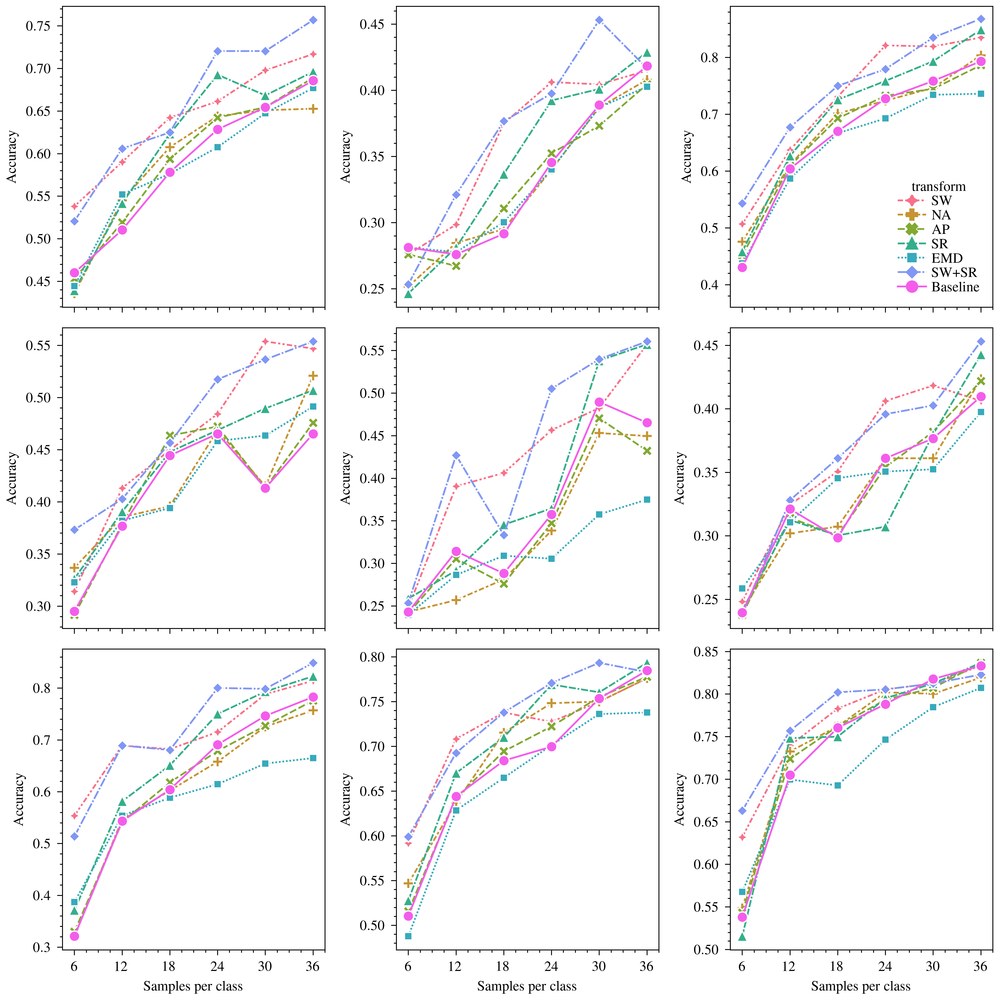

In [ ]:
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] != 3
c4 = df["n_classes"] == 4
data = df[c1 & c2 & c3 & c4].copy()

fig, ax = plt.subplots(figsize=(8, 8), nrows=3, ncols=3, sharex=True)
data.loc[data["keep_train"].isna(), "keep_train"] = 36

for subject in range(9):
    axis = ax[subject // 3, subject % 3]
    within_session(
        data=data[data["subject"] == (subject + 1)],
        ax=axis,
        hue_order=legend_order,
        labels=legend_labels,
        legend_visible=subject == 2
    )

fig.tight_layout()

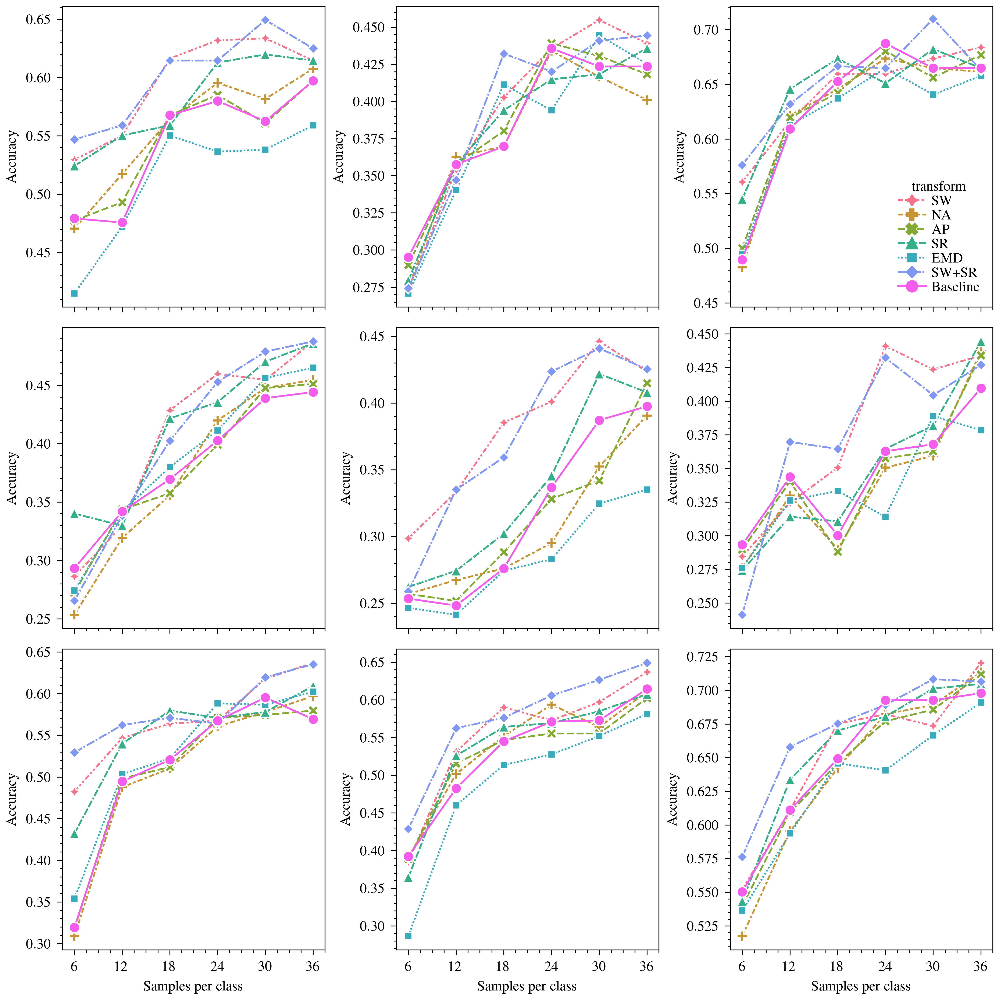

In [ ]:
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 3
c4 = df["n_classes"] == 4
data = df[c1 & c2 & c3 & c4].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36

fig, ax = plt.subplots(figsize=(8, 8), nrows=3, ncols=3, sharex=True)

for subject in range(9):
    axis = ax[subject // 3, subject % 3]
    within_session(
        data=data[data["subject"] == (subject + 1)],
        ax=axis,
        hue_order=legend_order,
        labels=legend_labels,
        legend_visible=subject == 2
    )

fig.tight_layout()

test_accuracy
keep_train transform                               
6.0        Baseline                        0.510417
           amplitude-perturbation-15       0.489583
           emd                             0.486111
           gaussian                        0.496528
           sliding-recombination           0.524306
           sliding-window-x                0.513889
           stft-recombination              0.517361
12.0       Baseline                        0.586806
           amplitude-perturbation-15       0.583333
           emd                             0.541667
           gaussian                        0.548611
           sliding-recombination           0.572917
           sliding-window-x                0.593750
           stft-recombination              0.500000
18.0       Baseline                        0.513889
           amplitude-perturbation-15       0.513889
           emd                             0.541667
           gaussian                        0.517361
           sliding-recombination           0.583333
           sliding-window-x                0.597222
           stft-recombination              0.559028
24.0       Baseline                        0.545139
           amplitude-perturbation-15       0.593750
           emd                             0.555556
           gaussian                        0.524306
           sliding-recombination           0.826389
           sliding-window-x                0.753472
           stft-recombination              0.631944
30.0       Baseline                        0.711806
           amplitude-perturbation-15       0.649306
           emd                             0.531250
           gaussian                        0.631944
           sliding-recombination           0.802083
           sliding-window-x                0.788194
           stft-recombination              0.645833
36.0       Baseline                        0.690972
           amplitude-perturbation-15       0.684028
           emd                             0.541667
           gaussian                        0.670139
           sliding-recombination           0.836806
           sliding-window-x                0.805556
           stft-recombination              0.743056

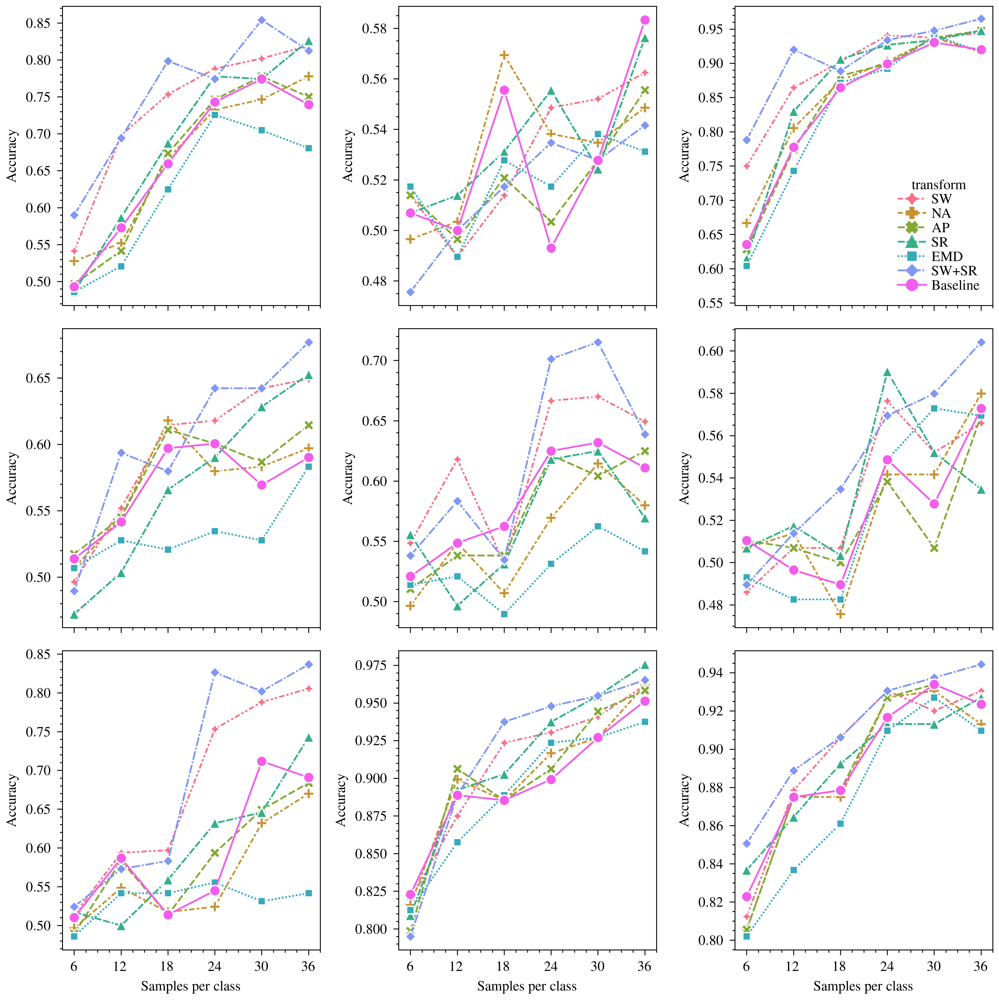

In [ ]:
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 2
data = df[c1 & c2 & c3 & c4].copy()
data.loc[data["keep_train"].isna(), "keep_train"] = 36

fig, ax = plt.subplots(figsize=(8, 8), nrows=3, ncols=3, sharex=True)

for subject in range(9):
    axis = ax[subject // 3, subject % 3]
    within_session(
        data=data[data["subject"] == (subject + 1)],
        ax=axis,
        hue_order=legend_order,
        labels=legend_labels,
        legend_visible=subject == 2
    )

fig.tight_layout()
display(data[data["subject"] == 7].groupby(["keep_train", "transform"]).mean()[["test_accuracy"]])

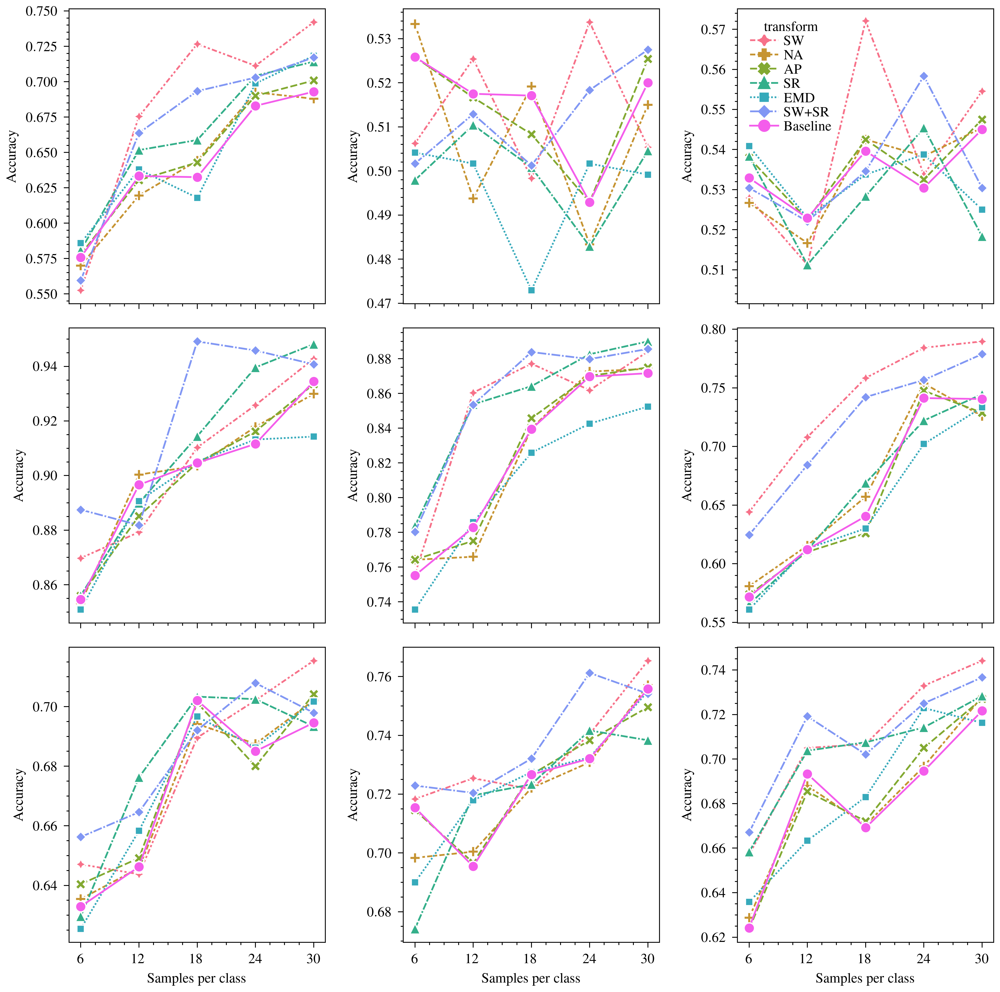

In [ ]:
c1 = df["dataset"] == "2b"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 3
c4 = df["n_classes"] == 2
data = df[c1 & c2 & c3 & c4].copy()

fig, ax = plt.subplots(figsize=(8, 8), nrows=3, ncols=3, sharex=True)

for subject in range(9):
    axis = ax[subject // 3, subject % 3]
    within_session(
        data=data[data["subject"] == (subject + 1)],
        ax=axis,
        hue_order=legend_order,
        labels=legend_labels,
        legend_visible=subject == 2
    )

fig.tight_layout()

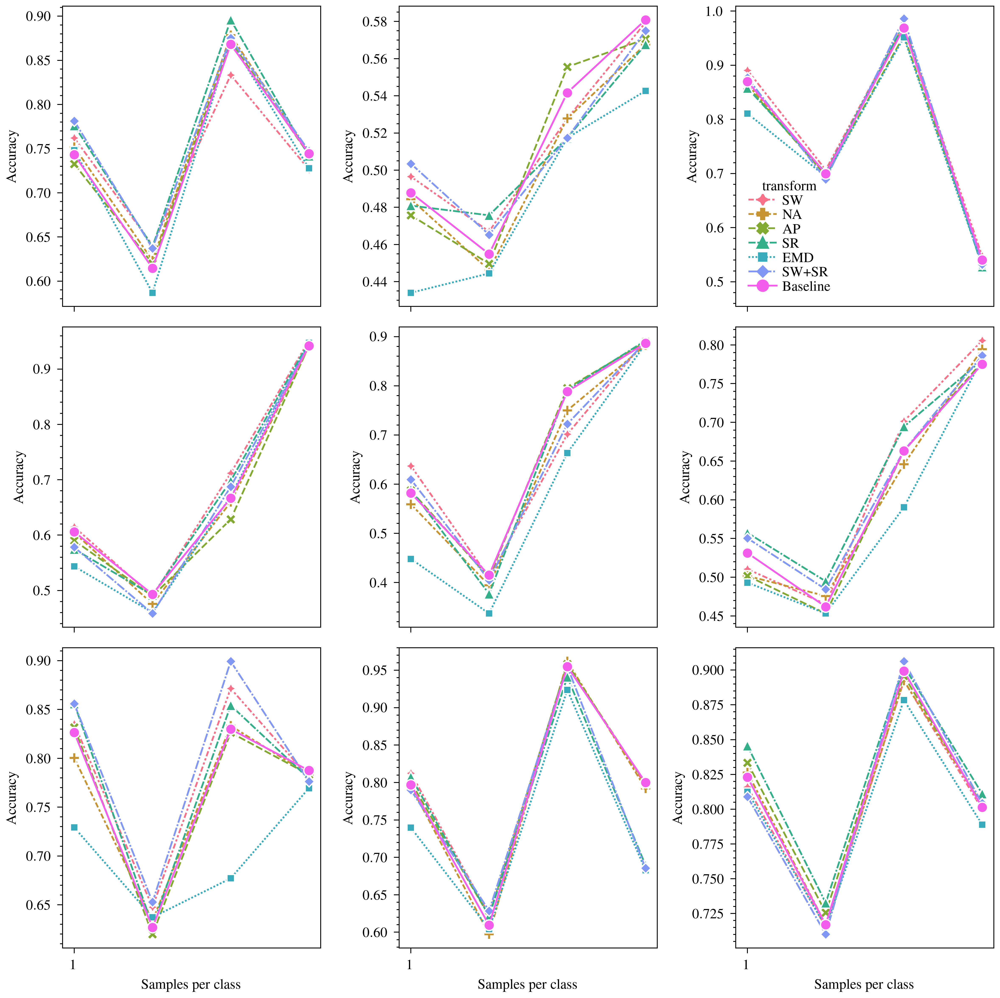

In [ ]:
c2 = df["intrasession"] == False
data = df[c2].copy()
data.loc[
    data["keep_train"].isna()
    & (data["dataset"] == "2a")
    & (data["n_electrodes"] == 22)
    & (data["n_classes"] == 4),
    "keep_train",
] = 1
data.loc[
    data["keep_train"].isna()
    & (data["dataset"] == "2a")
    & (data["n_electrodes"] == 3)
    & (data["n_classes"] == 4),
    "keep_train",
] = 2
data.loc[
    data["keep_train"].isna()
    & (data["dataset"] == "2a")
    & (data["n_electrodes"] == 22)
    & (data["n_classes"] == 2),
    "keep_train",
] = 3
data.loc[data["keep_train"].isna() & (data["dataset"] == "2b"), "keep_train"] = 4

fig, ax = plt.subplots(figsize=(8, 8), nrows=3, ncols=3, sharex=True)

for subject in range(9):
    axis = ax[subject // 3, subject % 3]
    within_session(
        data=data[data["subject"] == (subject + 1)],
        ax=axis,
        hue_order=legend_order,
        labels=legend_labels,
        legend_visible=subject == 2,
    )

fig.tight_layout()

### subject-wise within-session

In [ ]:
def subjectwise_within(data, ax, hue_order, show_labels=False, labels=None, show_y=True):
    s = sns.barplot(
        x="subject",
        y="test_accuracy",
        hue="transform",
        hue_order=hue_order,
        data=data,
        ci=None,
        ax=ax,
        edgecolor=".1",
        linewidth=0.4,
    )
    ax.set_xlabel("Subject ID")
    if show_y:
        ax.set_ylabel("Accuracy")
    else:
        ax.set_ylabel(None)
    ax.set_xticks([], minor=True)
    ax.set_ylim([0.0, 1.0])

    if show_labels:
        ax.legend(title=None, loc="upper center", bbox_to_anchor=(0.5, 1.025), ncol=4)
        if labels:
            for t, l in zip(ax.get_legend().texts, labels):
                t.set_text(l)
    else:
        ax.get_legend().remove()

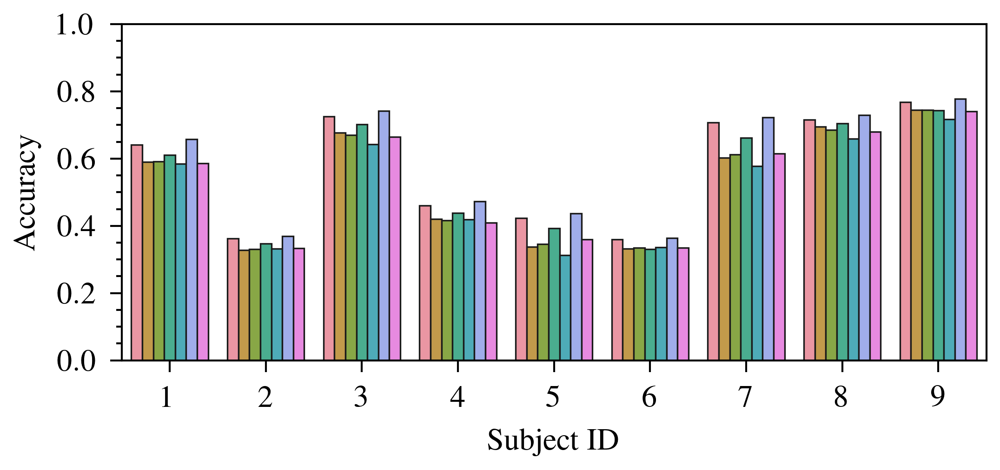

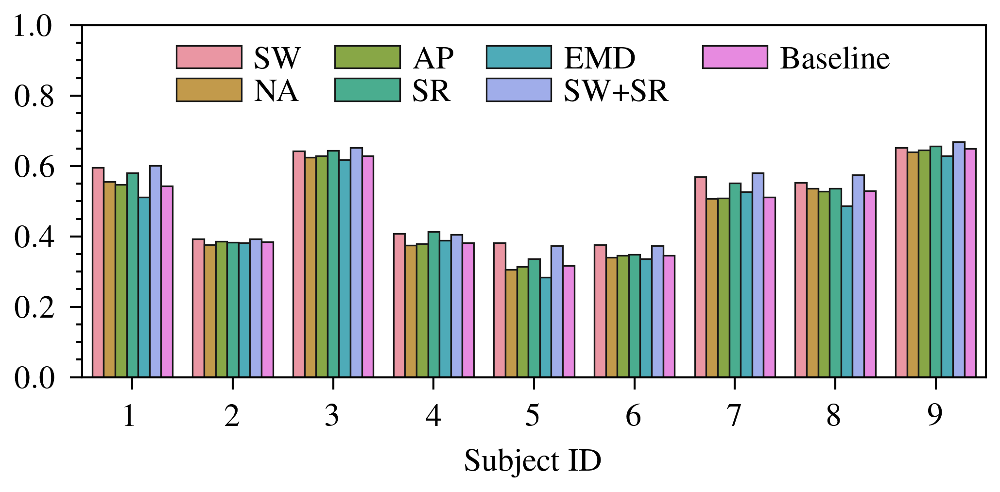

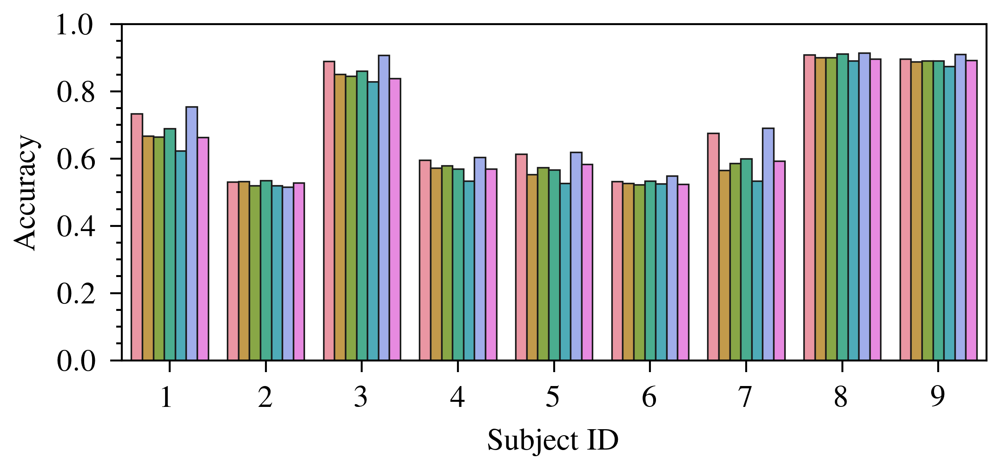

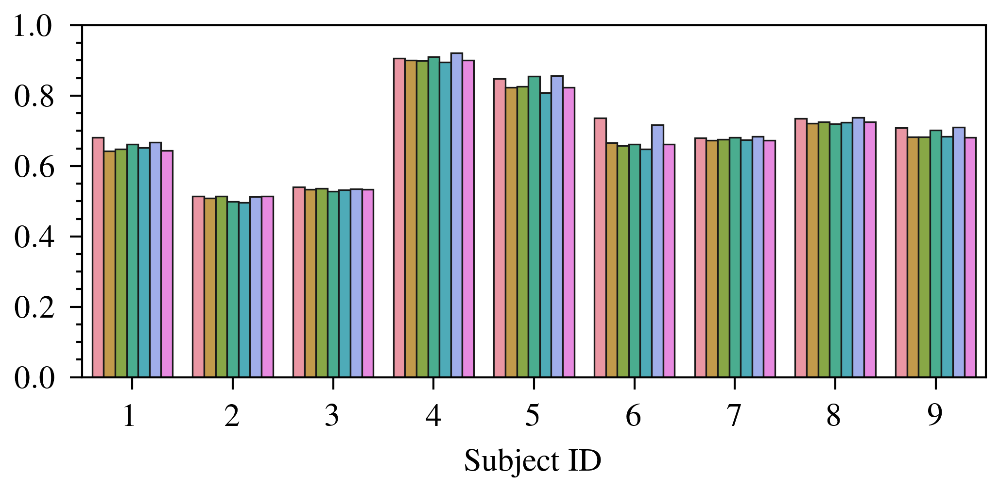

In [ ]:
figsize = (4, 1.6)

fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 4
data = df[c1 & c2 & c3 & c4].copy()
subjectwise_within(data, ax, hue_order=legend_order, show_labels=False, labels=legend_labels)
fig.savefig("../data/ws1.pdf", bbox_inches="tight")

fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 3
c4 = df["n_classes"] == 4
data = df[c1 & c2 & c3 & c4].copy()
subjectwise_within(data, ax, hue_order=legend_order, show_labels=True, labels=legend_labels, show_y=False)
fig.savefig("../data/ws2.pdf", bbox_inches="tight")

fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == True
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 2
data = df[c1 & c2 & c3 & c4].copy()
subjectwise_within(data, ax, hue_order=legend_order, show_labels=False, labels=legend_labels)
fig.savefig("../data/ws3.pdf", bbox_inches="tight")

fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2b"
c2 = df["intrasession"] == True
data = df[c1 & c2].copy()
subjectwise_within(data, ax, hue_order=legend_order, show_labels=False, labels=legend_labels, show_y=False)
fig.savefig("../data/ws4.pdf", bbox_inches="tight")

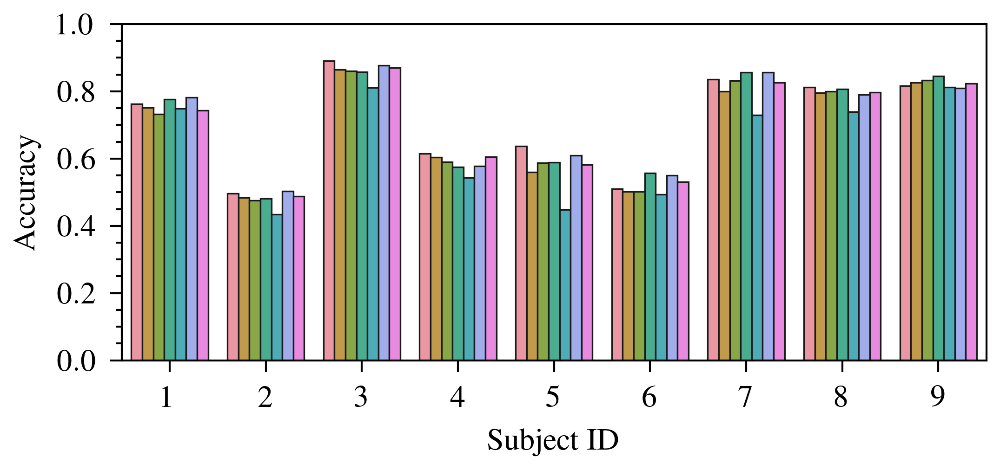

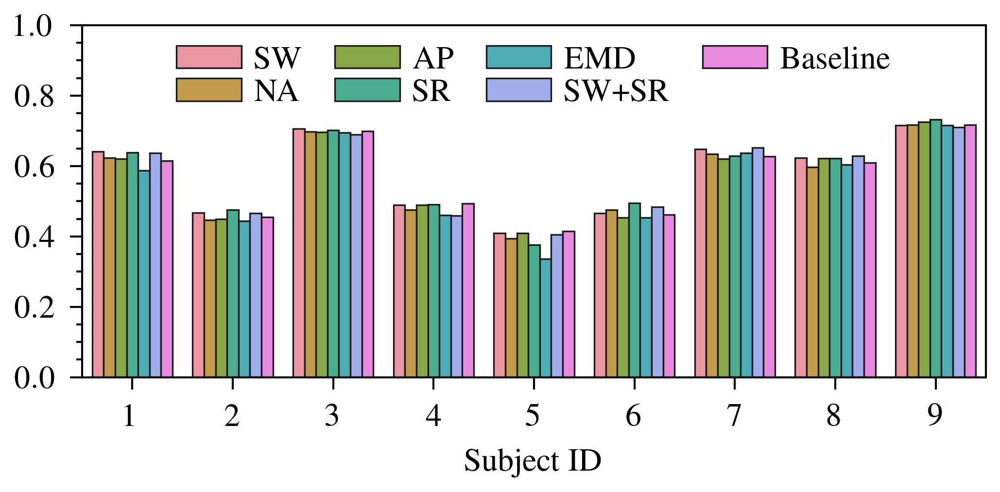

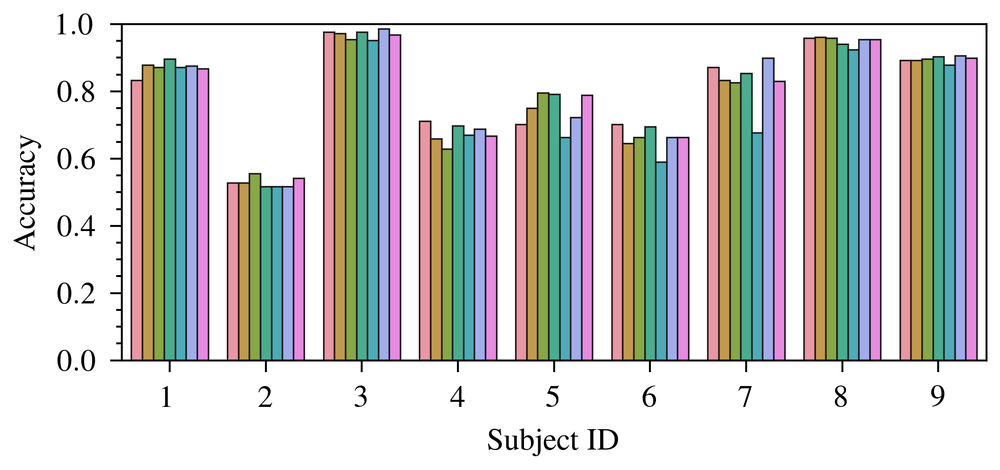

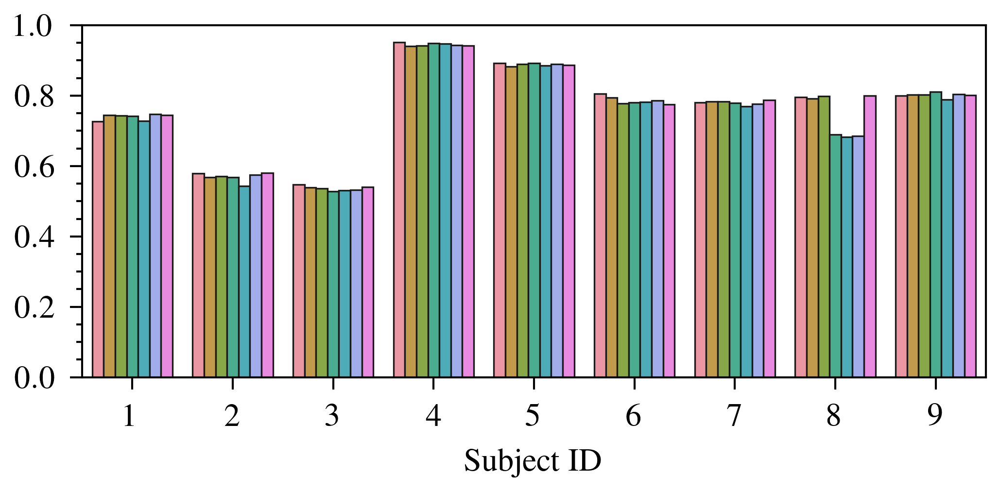

In [ ]:
figsize = (4, 1.6)

fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == False
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 4
data = df[c1 & c2 & c3 & c4].copy()
subjectwise_within(data, ax, hue_order=legend_order, show_labels=False, labels=legend_labels)
fig.savefig("../data/cs1.pdf", bbox_inches="tight")

fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == False
c3 = df["n_electrodes"] == 3
c4 = df["n_classes"] == 4
data = df[c1 & c2 & c3 & c4].copy()
subjectwise_within(data, ax, hue_order=legend_order, show_labels=True, labels=legend_labels, show_y=False)
fig.savefig("../data/cs2.pdf", bbox_inches="tight")

fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2a"
c2 = df["intrasession"] == False
c3 = df["n_electrodes"] == 22
c4 = df["n_classes"] == 2
data = df[c1 & c2 & c3 & c4].copy()
subjectwise_within(data, ax, hue_order=legend_order, show_labels=False, labels=legend_labels)
fig.savefig("../data/cs3.pdf", bbox_inches="tight")

fig, ax = plt.subplots(figsize=figsize)
c1 = df["dataset"] == "2b"
c2 = df["intrasession"] == False
data = df[c1 & c2].copy()
subjectwise_within(data, ax, hue_order=legend_order, show_labels=False, labels=legend_labels, show_y=False)
fig.savefig("../data/cs4.pdf", bbox_inches="tight")